# Vision & Cognitive Systems

## Final Project: Volumetric segmentation with enhanced medical images for 3D U-Net

- Student: Francisco Ariel Pasian
- Badge: 2078684

In [1]:
# Import
import os
import io
import sys
import numpy as np

import nibabel as nib
import tarfile
import json

import tempfile
from tqdm import tqdm
import time

import matplotlib.pyplot as plt
import imageio
import cv2
from skimage.transform import resize
from sklearn.model_selection import train_test_split

#!
#import gif_your_nifti.core as gif2nif

#
import torch
import torch.nn as nn
from torch.nn import Module
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torch.utils.data import Subset

#
from monai.metrics import DiceMetric, MeanIoU, PSNRMetric,SSIMMetric, HausdorffDistanceMetric
from monai.losses import DiceCELoss
from monai.transforms import (
    Compose,
    ToTensord,
    RandFlipd,
    Spacingd,
    RandScaleIntensityd,
    RandShiftIntensityd,
    NormalizeIntensityd,
    DivisiblePadd,
    Activations,
    AsDiscrete,
    ScaleIntensityd
)
from monai.networks.utils import one_hot
 

In [2]:
SEED = 12345
np.random.seed(SEED)
torch.manual_seed(SEED)

In [3]:
PATH = '' #'drive/MyDrive/Colab Notebooks/'

## 1) Data Pre-processing

Dataset with a collection of annotated medical image datasets of various clinically relevant anatomies (BraTS - https://www.med.upenn.edu/sbia/brats2017.html) and the JSON file contains information regarding the data together with the list of training and test sets.

Selected body organs:
- Heart
- Prostate


Reference: https://arxiv.org/pdf/1902.09063

Data source: http://medicaldecathlon.com/

### 1.1) Utils

In [4]:
# Function to extract a specific file from a tar archive
def extract_file_from_tar(tar_path, file_name, extract_path="."):
    with tarfile.open(tar_path, "r") as tar:
        tar.extract(file_name, path=extract_path)
        return os.path.join(extract_path, file_name)

# Function to load a NIfTI image
def load_nifti_image(file_path):
    nii_image = nib.load(file_path)
    return nii_image.get_fdata()

# Load and parse the JSON file
def load_json_file(json_path):
    with open(json_path, 'r') as f:
        return json.load(f)

# Function to recast label channels
def get_label_channels(labels):

    # count unique values
    n_labels = len(np.unique(labels))

    # split labels
    if n_labels == 1:
        return labels
    elif n_labels > 1:
        # generate binary masks for each unique label
        return np.stack([(labels == i).astype(np.uint8) for i in range(n_labels)], axis=-1)
    else:
        raise ValueError(f"Unexpected number of labels: {n_labels}")


In [5]:
class CreateDataset(Dataset):
    def __init__(self, tar_path, json_data, folder_name, dataset_type, transform=None):
        self.tar_path = tar_path
        self.folder_path = folder_name
        self.dataset_type = dataset_type
        self.transform = transform

        self.n_modality = len(json_data['modality'])
        self.n_labels = len(json_data['labels'])

        if dataset_type == 'train':
            self.data = json_data['training']
        elif dataset_type == 'val':
            self.data = json_data['validation']
        elif dataset_type == 'test':
            self.data = json_data['test']
        else:
            raise ValueError("ERROR: dataset type is not declared")

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        entry = self.data[idx]

        if self.dataset_type == 'train' or self.dataset_type == 'val':
            image_file = entry['image'].replace("./", self.folder_path)
            label_file = entry['label'].replace("./", self.folder_path)

            with tempfile.TemporaryDirectory() as temp_dir:
                # Extract the image and label from the tar file
                extracted_image_path = extract_file_from_tar(self.tar_path, image_file, extract_path=temp_dir)
                extracted_label_path = extract_file_from_tar(self.tar_path, label_file, extract_path=temp_dir)

                # Load the image and label data
                image_data = load_nifti_image(extracted_image_path)
                label_data = load_nifti_image(extracted_label_path)
                # expand label channels
                label_data = get_label_channels(label_data)

                # Handle varying number of channels
                if len(image_data.shape) == 3:
                    # Add a channel dimension for single channel images
                    image_data = np.expand_dims(image_data, axis=-1)

                # channel-first numpy array
                image_data = np.moveaxis(image_data, -1, 0)
                label_data= np.moveaxis(label_data, -1, 0)

                # Prepare data for transformation
                processed_out = {'image': image_data, 'label': label_data}
                # Apply transformations
                if self.transform is not None: #and is_augmented:
                    transformed = self.transform(processed_out)
                    image_tensor = transformed['image'].to(torch.float32)
                    label_tensor = transformed['label'].to(torch.float32)
                else:
                    # Convert to tensors if no transformation
                    image_tensor = torch.tensor(image_data, dtype=torch.float32)
                    label_tensor = torch.tensor(label_data, dtype=torch.float32)

            return image_tensor, label_tensor
        else:
            # TEST
            image_file = entry.replace("./", self.folder_path) #"Task01_BrainTumour/")
            with tempfile.TemporaryDirectory() as temp_dir:
                # Extract the image from the tar file
                extracted_image_path = extract_file_from_tar(self.tar_path, image_file, extract_path=temp_dir)
                # Load the image and label data
                image_data = load_nifti_image(extracted_image_path)

                # Handle varying number of channels
                if len(image_data.shape) == 3:
                    # Add a channel dimension for single channel images
                    image_data = np.expand_dims(image_data, axis=-1)

                # channel-first numpy array
                image_data = np.moveaxis(image_data, -1, 0)
                # Convert to tensor
                image_tensor = torch.tensor(image_data, dtype=torch.float32)

            return image_tensor


In [6]:
#Transforms to be applied on training instances
train_transform = Compose(
    [
        #AddChanneld(keys=["image", "label"]),
        #Spacingd(keys=['image', 'label'], pixdim=(1., 1., 1.), mode=("bilinear", "nearest")),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=0),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=1),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=2),
        #NormalizeIntensityd(keys='image', nonzero=True, channel_wise=True),
        RandScaleIntensityd(keys='image', factors=0.1, prob=1.0),
        RandShiftIntensityd(keys='image', offsets=0.1, prob=1.0),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)

#Transforms to be applied on validation instances
val_transform = Compose(
    [
        #AddChanneld(keys=["image", "label"]),
        #NormalizeIntensityd(keys='image', nonzero=True, channel_wise=True),
        #ScaleIntensityd(keys="image"),  # Normalize intensity like in training
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=0),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=1),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=2),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)



## with normalization
train_transform_norm = Compose(
    [
        #AddChanneld(keys=["image", "label"]),
        #Spacingd(keys=['image', 'label'], pixdim=(1., 1., 1.), mode=("bilinear", "nearest")),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=0),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=1),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=2),
        NormalizeIntensityd(keys='image', nonzero=True, channel_wise=True),
        RandScaleIntensityd(keys='image', factors=0.1, prob=1.0),
        RandShiftIntensityd(keys='image', offsets=0.1, prob=1.0),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)

#Transforms to be applied on validation instances
val_transform_norm = Compose(
    [
        #AddChanneld(keys=["image", "label"]),
        NormalizeIntensityd(keys='image', nonzero=True, channel_wise=True),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)

In [7]:
def filter_invalid_entries(tar_path, json_data, folder_path):
    """ Get all valid and invalid file names, based on the fact that we want the number of modality and labels as mentioned in the JSON metadata info
    """

    n_modality = len(json_data['modality'])
    n_labels = len(json_data['labels'])
    data = json_data['training']

    invalid_data = {'modality':[] , 'label':[]}
    valid_data = []

    for entry in data:
        label_file = entry['label'].replace("./", folder_path)
        image_file = entry['image'].replace("./", folder_path)

        with tempfile.TemporaryDirectory() as temp_dir:
            # Extract the image and label from the tar file
            extracted_image_path = extract_file_from_tar(tar_path, image_file, extract_path=temp_dir)
            extracted_label_path = extract_file_from_tar(tar_path, label_file, extract_path=temp_dir)
            # Load the image and label data
            image_data = load_nifti_image(extracted_image_path)
            label_data = load_nifti_image(extracted_label_path)
            # expand label channels
            label_data = get_label_channels(label_data)

            # Check for incomplete labels or modality
            if label_data.shape[-1] != n_labels:
                invalid_data['label'].append( extracted_label_path )
                if image_data.shape[-1] != n_modality:
                    invalid_data['modality'].append(extracted_image_path)
                    continue
            else:
                valid_data.append(entry)

    return valid_data, invalid_data

In [8]:
def get_train_val_test_dataloader(tar_path,json_file_name, folder_name, BATCH_SIZE = 1, transforms=[None,None], seed=SEED):

    # Extract and load the JSON file
    with tempfile.TemporaryDirectory() as temp_dir:
        extracted_json_path = extract_file_from_tar(tar_path, json_file_name, extract_path=temp_dir)
        json_data = load_json_file(extracted_json_path)

    # check if there is incomplete channels or labels
    valid_data, invalid_data = filter_invalid_entries(tar_path, json_data, folder_name)
    print('Incomplete labels: ', len(invalid_data['label']), '- Incomplete modality: ', len(invalid_data['modality']) )

    # Split validation dataset
    json_data_train, json_data_val = train_test_split(valid_data, test_size= 0.25, random_state=seed)
    json_data['validation'] = json_data_val
    json_data['training'] = json_data_train

    # Create the dataset
    print('transform: ', transforms)
    training_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='train', transform=transforms[0])
    val_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='val', transform=transforms[1])
    test_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='test')

    #val_dataset, test_dataset = train_test_split(validation_dataset , test_size=0.5)
    #training_dataset, val_dataset = torch.utils.data.random_split(training_dataset, [0.8, 0.2])

    # Create dataloader
    train_dataloader = DataLoader(training_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)
    val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)
    test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)

    print(folder_name,
        '\nTotal training data: ', len(train_dataloader),
        '\nTotal validation data: ', len(val_dataloader),
        '\nTotal test data: ', len(test_dataloader),
        '\n----')

    return train_dataloader, val_dataloader, test_dataloader

def get_train_val_test_dataloader2(tar_path,json_file_name, folder_name, BATCH_SIZE = 1, transforms=[None,None], seed=SEED):

    # Extract and load the JSON file
    with tempfile.TemporaryDirectory() as temp_dir:
        extracted_json_path = extract_file_from_tar(tar_path, json_file_name, extract_path=temp_dir)
        json_data = load_json_file(extracted_json_path)

    # check if there is incomplete channels or labels
    valid_data, invalid_data = filter_invalid_entries(tar_path, json_data, folder_name)
    print('Incomplete labels: ', len(invalid_data['label']), '- Incomplete modality: ', len(invalid_data['modality']) )

    # Split validation dataset
    json_data_train, json_data_val = train_test_split(valid_data, test_size= 0.25, random_state=seed)
    json_data['validation'] = json_data_val
    json_data['training'] = json_data_train

    # Create the dataset
    print('transform: ', transforms)
    training_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='train', transform=transforms[0])
    val_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='val', transform=transforms[1])
    test_dataset = CreateDataset(tar_path, json_data, folder_name, dataset_type='test')

    #val_dataset, test_dataset = train_test_split(validation_dataset , test_size=0.5)
    #training_dataset, val_dataset = torch.utils.data.random_split(training_dataset, [0.8, 0.2])

    # Function to select a subset (keep 50% of the data)
    def get_subset(dataset, fraction=0.5):         
        num_samples = len(dataset)         
        subset_indices = np.random.choice(num_samples, int(num_samples * fraction), replace=False)         
        return Subset(dataset, subset_indices) 
    # Reduce datasets to 50% 
    training_dataset = get_subset(training_dataset, 0.15) 
    val_dataset = get_subset(val_dataset, 0.15)
    test_dataset = get_subset(test_dataset, 0.1)

    # Create dataloader
    train_dataloader = DataLoader(training_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)
    val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)
    test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True)#, num_workers=4)

    print(folder_name,
        '\nTotal training data: ', len(train_dataloader),
        '\nTotal validation data: ', len(val_dataloader),
        '\nTotal test data: ', len(test_dataloader),
        '\n----')

    return train_dataloader, val_dataloader, test_dataloader

In [59]:
# PLOT FUNCTIONS


# Function to plot orthogonal views for a given modality
def plot_orthoview(image_data, modality):
    modality_index, modality_name = modality

    try:
      # Get the dimensions
      x, y, z, _ = image_data.shape
      # Extract slices: Axial (XY), Coronal (XZ), Sagittal (YZ)
      axial_slice = image_data[:, :, z // 2, modality_index]  # XY plane
      coronal_slice = image_data[:, y // 2, :, modality_index]  # XZ plane
      sagittal_slice = image_data[x // 2, :, :, modality_index]  # YZ plane
    except:
      # Get the dimensions
      x, y, z = image_data.shape
      # Extract slices: Axial (XY), Coronal (XZ), Sagittal (YZ)
      axial_slice = image_data[:, :, z // 2]  # XY plane
      coronal_slice = image_data[:, y // 2,:]  # XZ plane
      sagittal_slice = image_data[x // 2, :, :]  # YZ plane

    # Plot the slices
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(axial_slice.T, cmap='gray', origin='lower')
    axes[0].set_title('Axial View (XY)')
    axes[0].axis('off')

    axes[1].imshow(coronal_slice.T, cmap='gray', origin='lower')
    axes[1].set_title('Coronal View (XZ)')
    axes[1].axis('off')

    axes[2].imshow(sagittal_slice.T, cmap='gray', origin='lower')
    axes[2].set_title('Sagittal View (YZ)')
    axes[2].axis('off')

    plt.suptitle(f"{modality_name} [{modality_index}]")
    plt.show()


# create GIF for each modality/label
def create_gif(image_data, modality, gif_path ,duration=0.1, save_gif=True):
    modality_index, modality_name = modality
    frames = []
    for i in range(image_data.shape[2]):

        fig, ax = plt.subplots(nrows=1,ncols=len(modality_index),figsize=(10,5))

        if len(modality_index) == 1:
            ax.imshow(image_data[:, :, i], cmap='gray')
            ax.set_title(f'{modality_name} - Slice {i}')
            ax.axis('off')
        else:
            for m in modality_index:
                ax[m].imshow(image_data[:, :, i, m], cmap='gray')
                ax[m].set_title(f'{modality_name[m]} [{m}] \n Slice {i}')
                ax[m].axis('off')

        # Adjust layout to minimize white space
        plt.tight_layout(pad=0.5,h_pad=0.1)  # You can adjust the padding as needed
        plt.subplots_adjust(wspace=0.1, hspace=0.1)  # Fine-tune the spacing

        # Convert plot to image and append to frames
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        frames.append(image)
        plt.close(fig)

    imageio.mimsave(gif_path, frames, duration=duration)


# create GIF for both modality & label
def create_gif_2(image_data, modality, stacked_labels, annotation, gif_path, duration=0.1):
    """
    Creates a GIF figure with all modalities and all labels (each label is plotted separated with a given color)
    """
    modality_index, modality_name = modality
    annotation_index, annotation_name = annotation
    frames = []
    for i in range(image_data.shape[2]):

        fig, ax = plt.subplots(nrows=1,ncols=len(modality_index),figsize=(10,5))


        if len(modality_index) == 1:
            ax.imshow(image_data[:, :, i], cmap='gray')
            for l,c in zip(annotation_index, ['blue','magenta','green','red']):
                ax.contour(stacked_labels[:, :, i, l], colors=c, linewidths=0.5)
            ax.set_title(f'{modality_name[0]} 0 - Slice {i} ')
            ax.axis('off')
        else:
            for m in modality_index:
                ax[m].imshow(image_data[:, :, i, m], cmap='gray')
                for l,c in zip(annotation_index, ['blue','magenta','green','red']):
                    ax[m].contour(stacked_labels[:, :, i, l], colors=c, linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 1], colors=['magenta'], linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 2], colors=['green'], linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 3], colors=['red'], linewidths=0.5)
                #ax[a,m].imshow(stacked_labels[:, :, i, a], cmap='viridis', alpha=0.3)
                ax[m].set_title(f'Modality {m} - Slice {i} ')
                ax[m].axis('off')

        # Adjust layout to minimize white space
        plt.tight_layout(pad=0.5,h_pad=0.1)  # You can adjust the padding as needed
        plt.subplots_adjust(wspace=0.1, hspace=0.1)  # Fine-tune the spacing

        # Convert plot to image and append to frames
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        frames.append(image)
        plt.close(fig)

    imageio.mimsave(gif_path, frames, duration=duration)

# create GIF for both modality & label
def create_gif_3(image_data, modality_index, stacked_labels, annotation_index, gif_path, duration=0.1):

    frames = []
    print(image_data.shape)
    print(stacked_labels.shape)
    for i in range(image_data.shape[2]):

        fig, ax = plt.subplots(nrows=1,ncols=len(modality_index),figsize=(10,5))


        if len(modality_index) == 1:
            ax.imshow(image_data[:, :, i], cmap='gray')
            for l,c in zip(annotation_index, ['blue','magenta','green','red']):
                ax.contour(stacked_labels[:, :, i, l], colors=c, linewidths=0.5)
            ax.set_title(f'Modality 0 - Slice {i} ')
            ax.axis('off')
        else:
            for m in modality_index:
                ax[m].imshow(image_data[:, :, i, m], cmap='gray')
                for l,c in zip(annotation_index, ['blue','magenta','green','red']):
                    ax[m].contour(stacked_labels[:, :, i, l], colors=c, linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 1], colors=['magenta'], linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 2], colors=['green'], linewidths=0.5)
                #ax[m].contour(stacked_labels[:, :, i, 3], colors=['red'], linewidths=0.5)
                #ax[a,m].imshow(stacked_labels[:, :, i, a], cmap='viridis', alpha=0.3)
                ax[m].set_title(f'Modality {m} - Slice {i} ')
                ax[m].axis('off')

        # Adjust layout to minimize white space
        plt.tight_layout(pad=0.5,h_pad=0.1)  # You can adjust the padding as needed
        plt.subplots_adjust(wspace=0.1, hspace=0.1)  # Fine-tune the spacing

        # Convert plot to image and append to frames
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        frames.append(image)
        plt.close(fig)

    imageio.mimsave(gif_path, frames, duration=duration)

def plot_images(features, labels, organ):
    plt.figure(figsize=(15, 5))
    
    if organ == 'heart':
        img = features[0].squeeze()[:, :, int(features[0].shape[-1]//2)]
        label = labels[0]
        
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap="gray")
        plt.title("Image")
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label[0, :, :, int(features[0].shape[-1]//2)], cmap="gray")
        plt.title("Label")
        plt.axis('off')
        
    else:
        img = features[0].squeeze()[:, :, :, int(features[0].shape[-1]//2)]
        print(labels.shape)
        label = labels[0]
        
        num_labels = len(labels)
        print(num_labels)
        for i in range(num_labels):
            plt.subplot(1, num_labels + 1, i + 1)
            plt.imshow(img[i, :, :], cmap="gray")
            plt.title(f"Image {i+1}")
            plt.axis('off')
        
        for i in range(num_labels):
            plt.subplot(2, num_labels + 1, num_labels + i + 1)
            plt.imshow(label[i, :, :, int(features[0].shape[-1]//2)], cmap="gray")
            plt.title(f"Label {i+1}")
            plt.axis('off')
    
    plt.tight_layout()
    plt.show()

### 1.2) Visualization - EDA

- Load a sample data

In [10]:
# Datafile paths
tar_path = PATH + "data/Task02_Heart.tar"
# sample
image_file = "Task02_Heart/imagesTr/la_010.nii.gz"
label_file = "Task02_Heart/labelsTr/la_010.nii.gz"

# JSON file path
json_file_name = "Task02_Heart/dataset.json"

In [11]:
# Extract the image and label from the tar file
extracted_image_path = extract_file_from_tar(tar_path, image_file)
extracted_label_path = extract_file_from_tar(tar_path, label_file)

# Load a NIfTI image
img_sample = nib.load(extracted_image_path)
label_sample = nib.load(extracted_label_path)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


In [12]:
# Extract and load the JSON file
with tempfile.TemporaryDirectory() as temp_dir:
    extracted_json_path = extract_file_from_tar(tar_path, json_file_name, extract_path=temp_dir)
    json_data = load_json_file(extracted_json_path)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


In [13]:
json_data

{'name': 'LeftAtrium',
 'description': 'Left atrium segmentation',
 'tensorImageSize': '3D',
 'reference': 'King’s College London',
 'licence': 'CC-BY-SA 4.0',
 'relase': '1.0 04/05/2018',
 'modality': {'0': 'MRI'},
 'labels': {'0': 'background', '1': 'left atrium'},
 'numTraining': 20,
 'numTest': 10,
 'training': [{'image': './imagesTr/la_007.nii.gz',
   'label': './labelsTr/la_007.nii.gz'},
  {'image': './imagesTr/la_019.nii.gz', 'label': './labelsTr/la_019.nii.gz'},
  {'image': './imagesTr/la_023.nii.gz', 'label': './labelsTr/la_023.nii.gz'},
  {'image': './imagesTr/la_005.nii.gz', 'label': './labelsTr/la_005.nii.gz'},
  {'image': './imagesTr/la_009.nii.gz', 'label': './labelsTr/la_009.nii.gz'},
  {'image': './imagesTr/la_017.nii.gz', 'label': './labelsTr/la_017.nii.gz'},
  {'image': './imagesTr/la_021.nii.gz', 'label': './labelsTr/la_021.nii.gz'},
  {'image': './imagesTr/la_029.nii.gz', 'label': './labelsTr/la_029.nii.gz'},
  {'image': './imagesTr/la_003.nii.gz', 'label': './label

In [14]:
# types of MRI images
json_data['modality']

{'0': 'MRI'}

In [15]:
# labels names
json_data['labels']

{'0': 'background', '1': 'left atrium'}

- NIfTI image and label info

In [16]:
print(img_sample.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 320 320 120   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float32
bitpix          : 32
slice_start     : 0
pixdim          : [1.   1.25 1.25 1.37 0.   0.   0.   0.  ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'5.0.10'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.0
quatern_c       : 0.0
quatern_d       : 0.0
qoffset_x       : 0.0
qoffset_y       : 0.0
qoffset_z       : 0.0
srow_x          : [1.25 0.   0.

In [17]:
print(label_sample.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 320 320 120   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : uint8
bitpix          : 8
slice_start     : 0
pixdim          : [1.   1.25 1.25 1.37 0.   0.   0.   0.  ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'5.0.10'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.0
quatern_c       : 0.0
quatern_d       : 0.0
qoffset_x       : 0.0
qoffset_y       : 0.0
qoffset_z       : 0.0
srow_x          : [1.25 0.   0.   

- Orthogonal views

In [18]:
# Load the image
#img = nib.load(extracted_image_path)
image_data = img_sample.get_fdata()

print(image_data.shape)

(320, 320, 120)


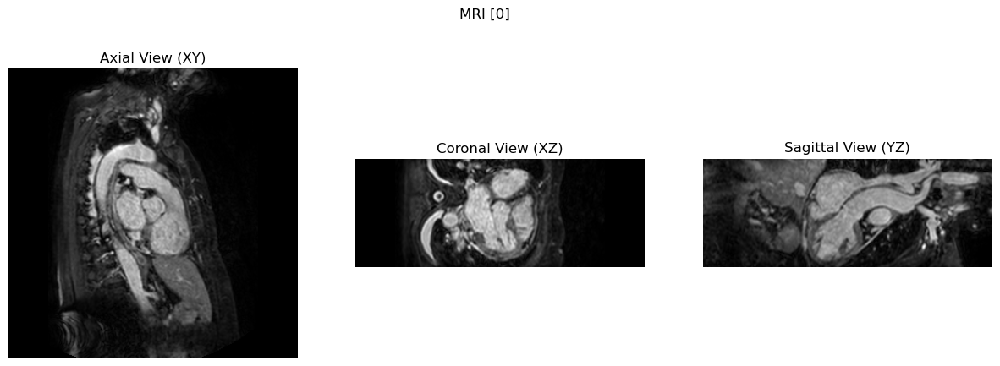

In [19]:
# Plot orthogonal views for each modality
# Shape should be (240, 240, 155, 4)
for modality in zip(range(1), json_data['modality'].values()):
    plot_orthoview(image_data, modality)


- Interactive slicer

In [20]:
"""
import ipywidgets as widgets
from ipywidgets import interact

# Display each slice and make it interactive with the user
# image_data is already loaded and has the shape (240, 240, 155, 4)
def display_slice(modality_index, slice_index):
    plt.figure(figsize=(6, 6))
    plt.imshow(image_data[:, :, slice_index, modality_index], cmap='gray')
    plt.title(f'Modality {modality_index} - Slice {slice_index}')
    plt.axis('off')
    plt.show()

# Create interactive widgets
modality_slider = widgets.IntSlider(min=0, max=1 - 1, step=1, value=0, description='Modality')
slice_slider = widgets.IntSlider(min=0, max=image_data.shape[2] - 1, step=1, value=image_data.shape[2] // 2, description='Slice')

# Create an interactive plot
interact(display_slice, modality_index=modality_slider, slice_index=slice_slider)
"""

"\nimport ipywidgets as widgets\nfrom ipywidgets import interact\n\n# Display each slice and make it interactive with the user\n# image_data is already loaded and has the shape (240, 240, 155, 4)\ndef display_slice(modality_index, slice_index):\n    plt.figure(figsize=(6, 6))\n    plt.imshow(image_data[:, :, slice_index, modality_index], cmap='gray')\n    plt.title(f'Modality {modality_index} - Slice {slice_index}')\n    plt.axis('off')\n    plt.show()\n\n# Create interactive widgets\nmodality_slider = widgets.IntSlider(min=0, max=1 - 1, step=1, value=0, description='Modality')\nslice_slider = widgets.IntSlider(min=0, max=image_data.shape[2] - 1, step=1, value=image_data.shape[2] // 2, description='Slice')\n\n# Create an interactive plot\ninteract(display_slice, modality_index=modality_slider, slice_index=slice_slider)\n"

- Create a GIF to visualize all the slices

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\332422040.py:66: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')


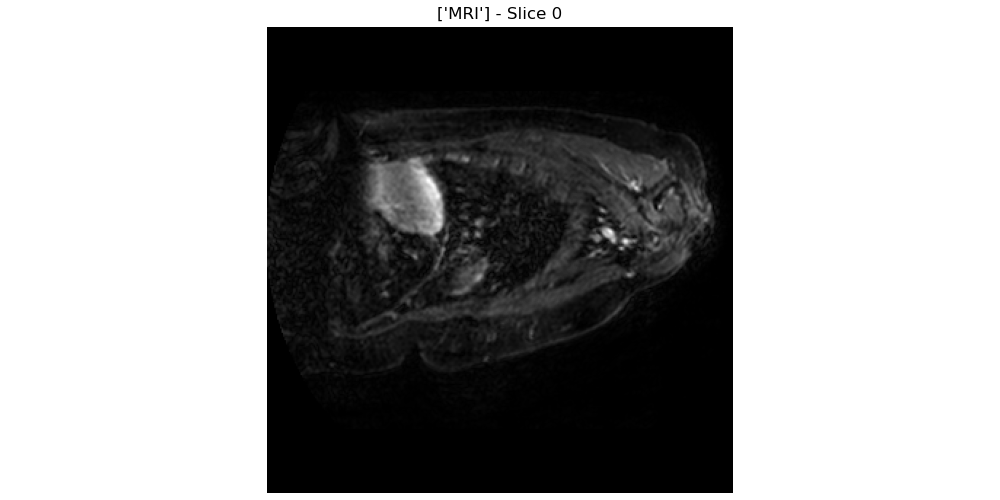

In [21]:
# Create GIF
modality_index = range(1)  # get all or change this to the desired modality
modality_names = list(json_data['modality'].values())
gif_path = 'heart_slices.gif'
create_gif(image_data, (modality_index, modality_names), gif_path)

# Display the GIF in Jupyter Notebook
from IPython.display import Image
Image(filename=gif_path)

- Explore labels

In [22]:
# labels are inside the matrix
label_sample_matrix = label_sample.get_fdata()

# print unique values
np.unique(label_sample_matrix[:,:,:])

array([0., 1.])

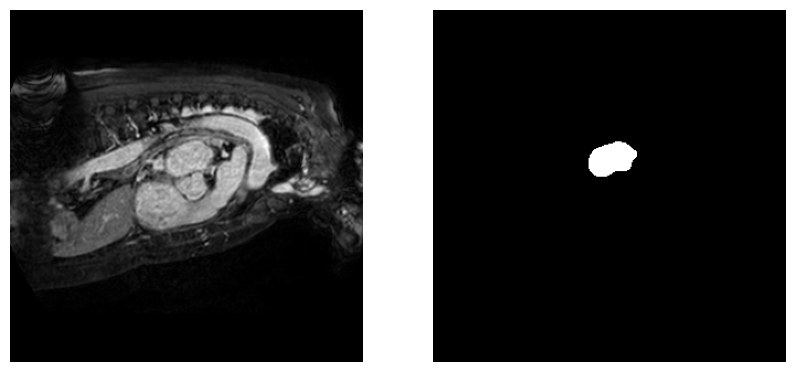

In [23]:
# plot labels
slice = 60

fig, ax = plt.subplots(1,2, figsize=(10,20))
# sample image
ax[0].imshow(image_data[:,:,slice], cmap='gray')
ax[0].axis('OFF')
#plt.show()

# labels
ax[1].imshow(label_sample_matrix[:,:,slice], cmap='gray')
ax[1].axis('OFF')

plt.show()

### 1.3) Other data visualization

In [24]:
def quick_data_view(tar_path, image_file, label_file, json_file_name):
    # Extract the image and label from the tar file
    extracted_image_path = extract_file_from_tar(tar_path, image_file)
    extracted_label_path = extract_file_from_tar(tar_path, label_file)

    # Load a NIfTI image
    img_sample = nib.load(extracted_image_path)
    label_sample = nib.load(extracted_label_path)

    # Extract and load the JSON file
    with tempfile.TemporaryDirectory() as temp_dir:
        extracted_json_path = extract_file_from_tar(tar_path, json_file_name, extract_path=temp_dir)
        json_data = load_json_file(extracted_json_path)

    # print JSON info
    print('----JSON file----')
    print('Modality: ',json_data['modality'], len(json_data['modality']), '\nLabels: ',json_data['labels'], len(json_data['labels']))

    return img_sample.get_fdata(), label_sample.get_fdata() , list(json_data['modality'].values()), list(json_data['labels'].values())

In [25]:
# Datafile paths
tar_path = PATH+ "data/Task02_Heart.tar"
# sample
image_file = "Task02_Heart/imagesTr/la_010.nii.gz"
label_file = "Task02_Heart/labelsTr/la_010.nii.gz"

# JSON file path
json_file_name = "Task02_Heart/dataset.json"

# get sample
image_data, label_sample_matrix, modality_names, annotation_names = quick_data_view(tar_path, image_file, label_file, json_file_name)

# split labels and stack
stacked_labels = get_label_channels(label_sample_matrix)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


----JSON file----
Modality:  {'0': 'MRI'} 1 
Labels:  {'0': 'background', '1': 'left atrium'} 2


- Visualization

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\332422040.py:111: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')


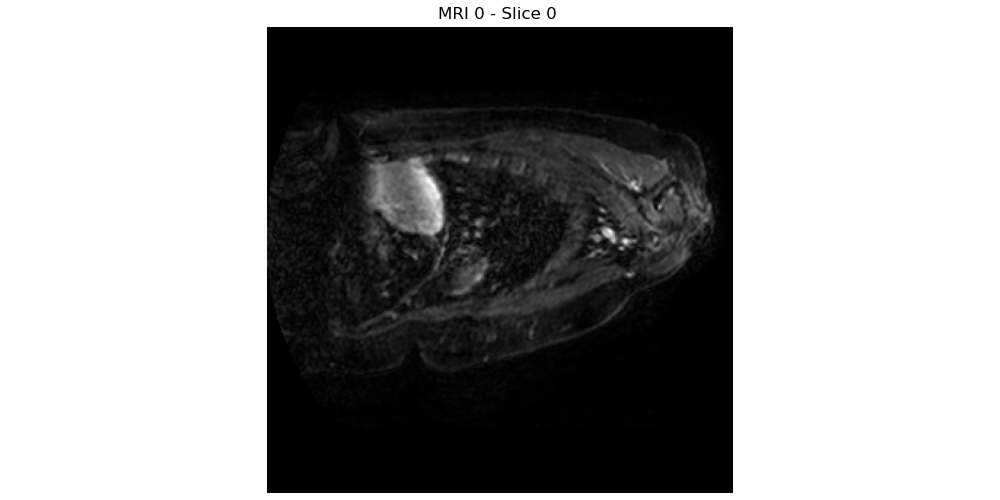

In [26]:
# create GIF
modality_index = range(1)   # get all or change this to the desired modality

annotation_index = range(stacked_labels.shape[3])  # number of annotations

gif_path = PATH + 'heart_label_slices_aa.gif'
create_gif_2(image_data, (modality_index, modality_names), stacked_labels, (annotation_index,annotation_names), gif_path)

# Display the GIF in Jupyter Notebook
from IPython.display import Image
Image(filename=gif_path)

### 1.4) Image Enhancement

In [27]:
image_data.shape

(320, 320, 120)

In [28]:
from monai.transforms import NormalizeIntensityd
from monai.data import DataLoader, Dataset

# Example data
data = [{'image': image_data}]

# Define the transform
transform = NormalizeIntensityd(keys=['image'], nonzero=True)

# Apply the transform
dataset = Dataset(data, transform=transform)
dataloader = DataLoader(dataset, batch_size=1)

for batch in dataloader:
    normalized_image = batch['image'][0,:,:,:].numpy()

# get the central slice of the image
central_slice_n = normalized_image[:,:,normalized_image.shape[-1]//2]
central_slice = image_data[:,:,image_data.shape[-1]//2]

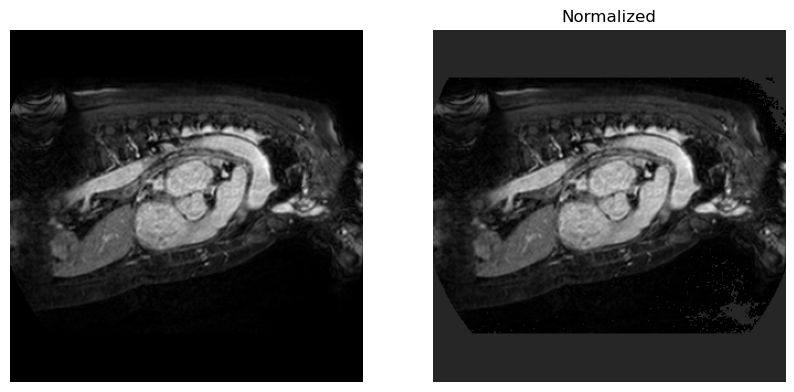

In [29]:
# compare orginal + normalized

fig, ax = plt.subplots(1,2, figsize=(10,15))
ax[0].imshow(central_slice, cmap='gray')
ax[1].imshow(central_slice_n, cmap='gray')
ax[0].axis('Off')
ax[1].axis('Off')
ax[1].set_title('Normalized')
plt.show()

#### 1.4.a) Edge detection techniques

In [30]:
def edge_detector(image, name='sobel', k=1, plot=False):

    if name == 'sobel':
        # sobel detector
        edges = cv2.Sobel( image, cv2.CV_64F, 1, 0, ksize=5 )
        img_edge = cv2.addWeighted( image.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32) , k, 0)

    if name=='canny':
        # Canny detector
        v = np.median(image)
        sigma = 0.33
        lower = int(max(0, (1.0 - sigma) * v))
        upper = int(min(255, (1.0 + sigma) * v))
        edges = cv2.Canny(cv2.convertScaleAbs(image), lower, upper)
        img_edge = cv2.addWeighted( image.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32) , k, 0)

    if name == 'laplacian':
        # Laplacian detector
        edges = cv2.Laplacian( cv2.convertScaleAbs(image), cv2.CV_64F )
        img_edge = cv2.addWeighted( image.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32) , k, 0)

    if name == 'robert':
        # Robert edge operator
        roberts_v = np.array([[1,0],[0,-1]])
        roberts_h = np.array([[0,1],[-1,0]])

        edges = cv2.filter2D( image, -1, roberts_v) + cv2.filter2D( image, -1, roberts_h)
        img_edge = cv2.addWeighted( image.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32) , k, 0)

    if name == 'prewitt':
        # Apply Prewitt edge detection
        kernelx = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]])
        kernely = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
        prewittx = cv2.filter2D(image, -1, kernelx)
        prewitty = cv2.filter2D(image, -1, kernely)
        edges = cv2.magnitude(prewittx, prewitty)
        img_edge = cv2.addWeighted( image.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32) , k, 0)


    if plot:
        fig, ax = plt.subplots(1,3, figsize=(10,10))

        ax[0].imshow(image, cmap='gray')
        ax[1].imshow(edges, cmap='gray')
        ax[2].imshow(img_edge, cmap='gray')
        ax[0].set_title('Original')
        ax[1].set_title(name)
        ax[2].set_title(f'Original + {name}')
        ax[0].axis('Off')
        ax[1].axis('Off')
        ax[2].axis('Off')
        plt.show()

    return edges, img_edge

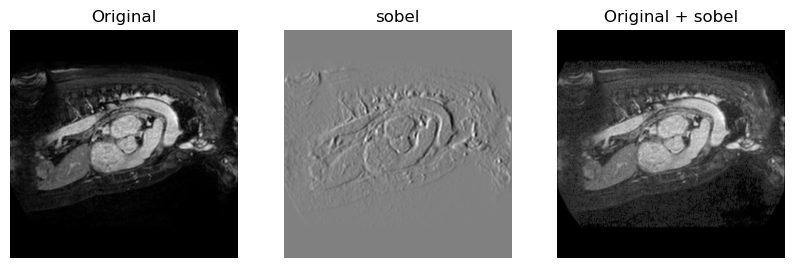

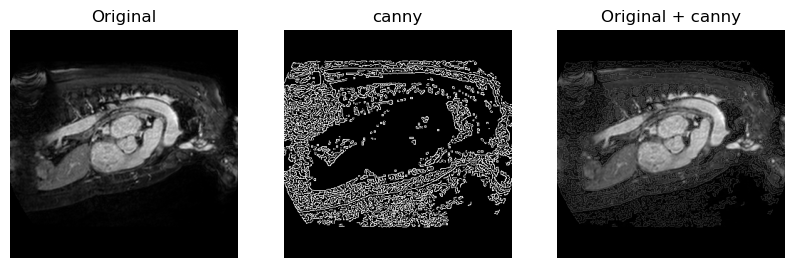

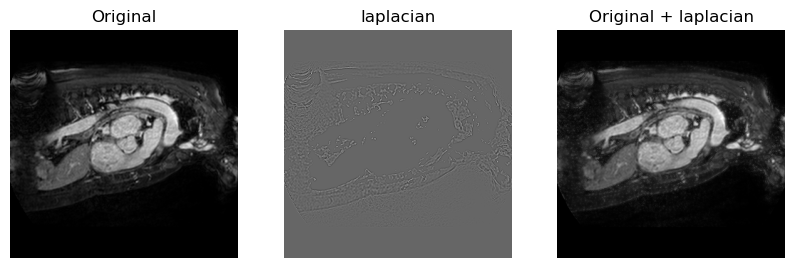

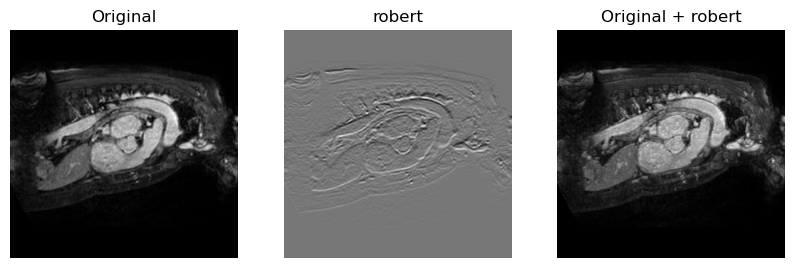

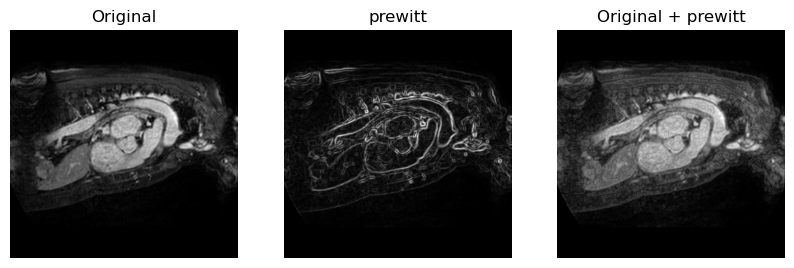

In [31]:
for name in ['sobel', 'canny', 'laplacian','robert','prewitt']:
    edge_detector(central_slice, name, plot=True)

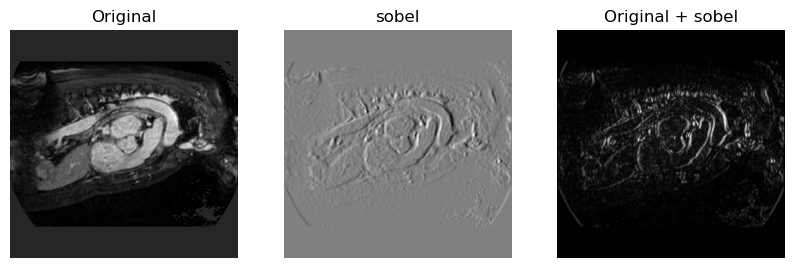

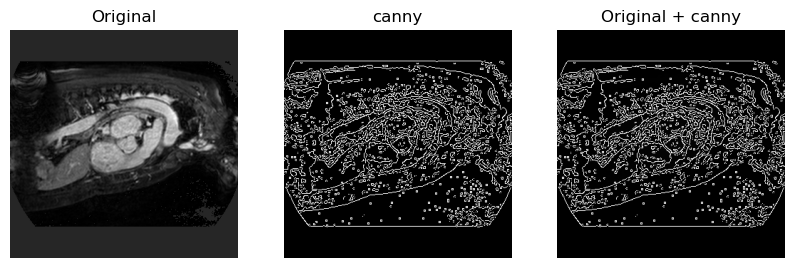

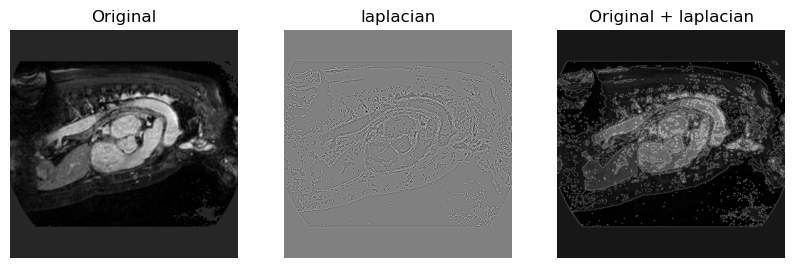

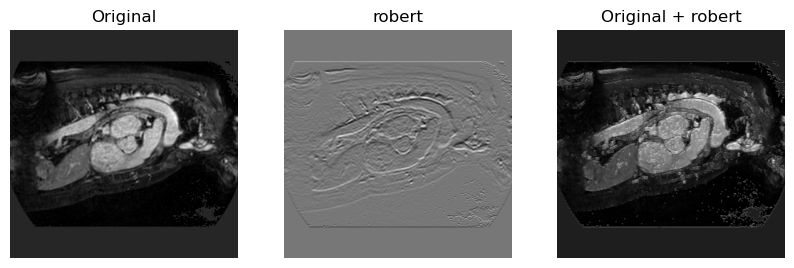

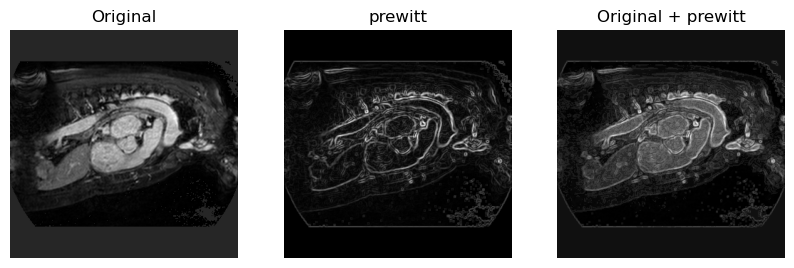

In [32]:
for name in ['sobel', 'canny', 'laplacian','robert','prewitt']:
    edge_detector(central_slice_n, name, plot=True)

#### 1.4.b) Histogram-based techniques

- Brightness Preserving Bi-Histogram Equalization (BBHE): divides the image histogram into two parts based on the mean intensity value and then applies histogram equalization to each part separately.

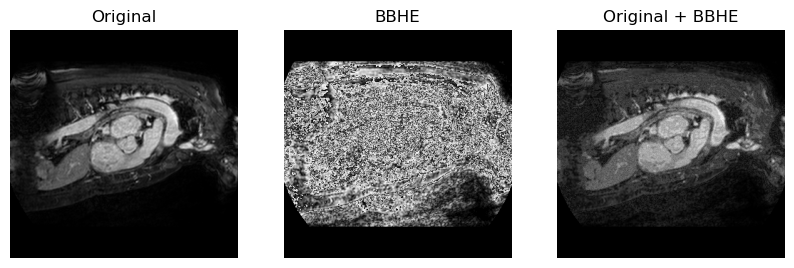

In [33]:
# BBHE function
def bbhe(image):
    image = image.astype(np.uint8)
    mean_intensity = np.mean(image)

    # Separate the image into two parts based on mean intensity
    lower_mask = image <= mean_intensity
    upper_mask = image > mean_intensity

    lower_part = image[lower_mask]
    upper_part = image[upper_mask]

    # Apply histogram equalization to both parts
    lower_hist_eq = cv2.equalizeHist(lower_part.astype(np.uint8))
    upper_hist_eq = cv2.equalizeHist(upper_part.astype(np.uint8))

    # Reconstruct the image
    result = np.copy(image)
    result[lower_mask] = lower_hist_eq.flatten()[:np.sum(lower_mask)]
    result[upper_mask] = upper_hist_eq.flatten()[:np.sum(upper_mask)]

    return result

# Apply BBHE to the central slice
#bbhe_image = bbhe((central_slice_normalized * 255).astype(np.uint8)) / 255.0
hist = bbhe(central_slice)

orig_hist = cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)

name = 'BBHE'

fig, ax = plt.subplots(1,3, figsize=(10,10))

ax[0].imshow(central_slice, cmap='gray')
ax[1].imshow(hist, cmap='gray')
ax[2].imshow(orig_hist, cmap='gray')
ax[0].set_title('Original')
ax[1].set_title(name)
ax[2].set_title(f'Original + {name}')
ax[0].axis('Off')
ax[1].axis('Off')
ax[2].axis('Off')
plt.show()

- Recursive Exposure-Based Sub-Image Histogram Equalization (R-ESIHE): recursively applies histogram equalization to sub-images based on exposure levels

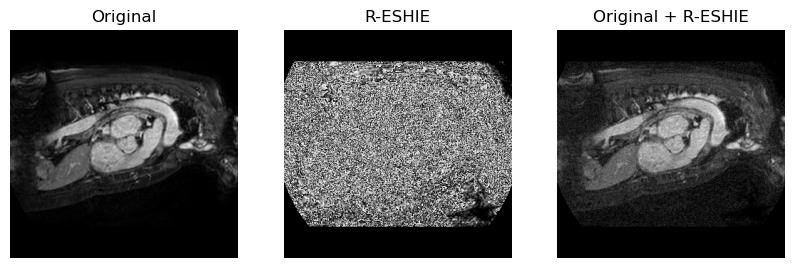

In [34]:
def exposure_based_segmentation(image, threshold):
    lower_part = image[image <= threshold]
    upper_part = image[image > threshold]
    return lower_part, upper_part

def recursive_hist_eq(image, depth=0):
    image = image.astype(np.uint8 )

    if depth == 2:  # Limiting depth to avoid too many recursions
        return cv2.equalizeHist(image)

    threshold = np.mean(image)
    lower_part, upper_part = exposure_based_segmentation(image, threshold)

    if lower_part.size > 0:
        equalized_lower = recursive_hist_eq(lower_part, depth + 1)
    else:
        equalized_lower = lower_part

    if upper_part.size > 0:
        equalized_upper = recursive_hist_eq(upper_part, depth + 1)
    else:
        equalized_upper = upper_part

    equalized_image = np.copy(image)
    equalized_image[image <= threshold] = equalized_lower.flatten()
    equalized_image[image > threshold] = equalized_upper.flatten()

    return equalized_image

# Apply R-ESIHE to the original image
#resi_image = recursive_hist_eq((central_slice * 255).astype(np.uint8)) / 255.0
hist = recursive_hist_eq(central_slice )

orig_hist = cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)

name = 'R-ESHIE'

fig, ax = plt.subplots(1,3, figsize=(10,10))

ax[0].imshow(central_slice, cmap='gray')
ax[1].imshow(hist, cmap='gray')
ax[2].imshow(orig_hist, cmap='gray')
ax[0].set_title('Original')
ax[1].set_title(name)
ax[2].set_title(f'Original + {name}')
ax[0].axis('Off')
ax[1].axis('Off')
ax[2].axis('Off')
plt.show()

- Adaptive Gamma Correction with Weighting Distribution (AGCWD): adjusts the gamma value based on the image histogram to enhance contrast.

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in log
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())


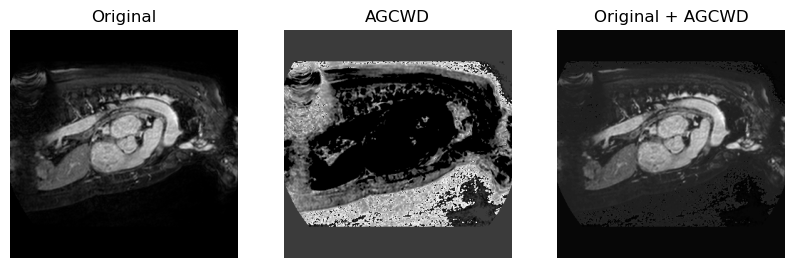

In [35]:
def agcwd(image, alpha=0.5):
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()

    gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())
    gamma_corrected = np.interp(image.flatten(), bins[:-1], gamma)
    gamma_corrected = gamma_corrected.reshape(image.shape)
    result = np.uint8(gamma_corrected * 255)

    return result

# Example usage
hist = agcwd(central_slice)
orig_hist = cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)

name = 'AGCWD'

fig, ax = plt.subplots(1,3, figsize=(10,10))

ax[0].imshow(central_slice, cmap='gray')
ax[1].imshow(hist, cmap='gray')
ax[2].imshow(orig_hist, cmap='gray')
ax[0].set_title('Original')
ax[1].set_title(name)
ax[2].set_title(f'Original + {name}')
ax[0].axis('Off')
ax[1].axis('Off')
ax[2].axis('Off')
plt.show()


- Nonlinear Quantization (NLQ): applies a nonlinear transformation to the image histogram.

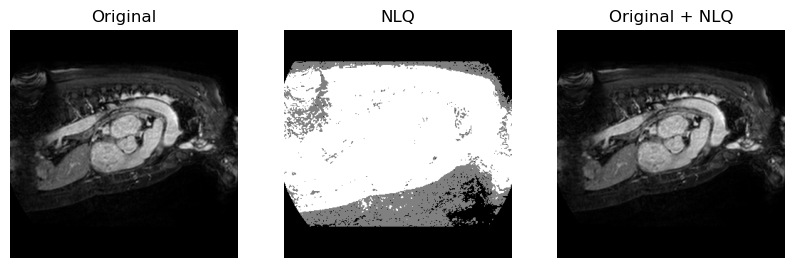

In [36]:
def nlq(image, alpha=0.5):
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()

    nlq_transform = np.log(1 + alpha * cdf_normalized) / np.log(1 + alpha)
    nlq_image = np.interp(image.flatten(), bins[:-1], nlq_transform)
    result = nlq_image.reshape(image.shape).astype(np.uint8)

    return result

# Example usage
hist = nlq(central_slice)
orig_hist = cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)

name = 'NLQ'

fig, ax = plt.subplots(1,3, figsize=(10,10))

ax[0].imshow(central_slice, cmap='gray')
ax[1].imshow(hist, cmap='gray')
ax[2].imshow(orig_hist, cmap='gray')
ax[0].set_title('Original')
ax[1].set_title(name)
ax[2].set_title(f'Original + {name}')
ax[0].axis('Off')
ax[1].axis('Off')
ax[2].axis('Off')
plt.show()

- Equalization Histogram & Constrast Limited Adaptive Histogram Equalization (CLAHE)

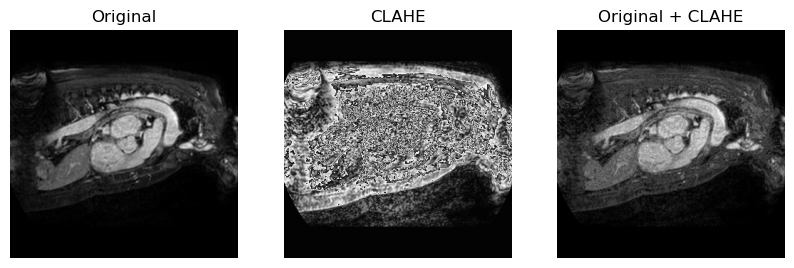

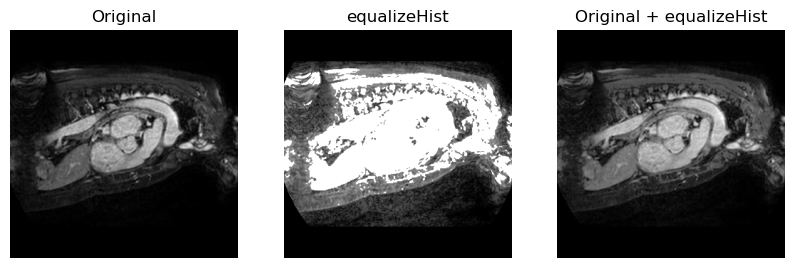

In [37]:
def equalize_hist(image, name, plot=False):

    if name=='equalizeHist':
        hist = cv2.equalizeHist(cv2.convertScaleAbs(image) )
        orig_hist = cv2.addWeighted( image.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)

    if name=='CLAHE':
        # Contrast Limited Adaptive Histogram Equalization
        hist = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(image.astype(np.uint8))
        orig_hist = cv2.addWeighted( image.astype(np.float64), 1, cv2.convertScaleAbs(hist).astype(np.float64) , 1, 0)


    if plot:
        fig, ax = plt.subplots(1,3, figsize=(10,10))

        ax[0].imshow(image, cmap='gray')
        ax[1].imshow(hist, cmap='gray')
        ax[2].imshow(orig_hist, cmap='gray')
        ax[0].set_title('Original')
        ax[1].set_title(name)
        ax[2].set_title(f'Original + {name}')
        ax[0].axis('Off')
        ax[1].axis('Off')
        ax[2].axis('Off')
        plt.show()

    return orig_hist

for name in ['CLAHE', 'equalizeHist']:
    equalize_hist(central_slice, name, plot=True)


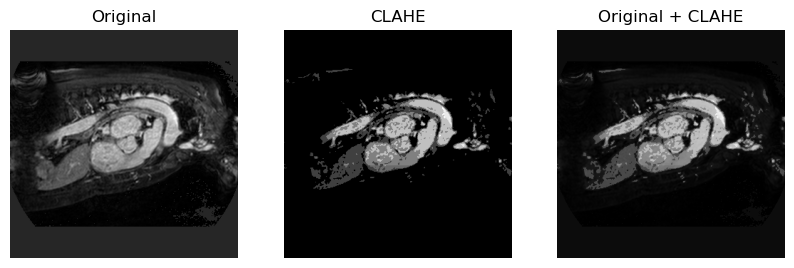

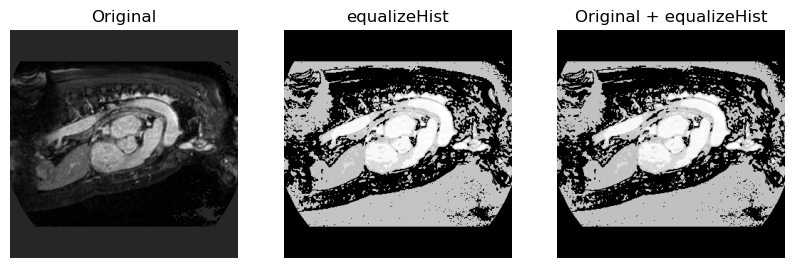

In [38]:
for name in ['CLAHE', 'equalizeHist']:
    equalize_hist(central_slice_n, name, plot=True)

#### 1.4.c) Quality Assessment Metrics

Let’s use MONAI and numpy to calculate some quality assessment metrics like entropy, enhancement measure, enhancement measure of entropy, PSNR, and SSIM.

In [39]:
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
from skimage.measure import shannon_entropy
#from skimage.color import rgb2gray
from skimage.util import view_as_blocks


def benchmark(original, enhanced):
    original, enhanced = original.astype(np.uint8), enhanced.astype(np.uint8)
    # peak signal to noise ratio
    psnr_value = psnr(original, enhanced)
    # structural similarity index measure
    ssim_value, _ = ssim(original, enhanced, full=True)
    return psnr_value, ssim_value


def calculate_EME(image, block_size):
    """ Enhancement Measure (EME) divides the image intro smaller blocks and compute local contrast in each block
    """
    blocks = view_as_blocks(image, block_shape=(block_size, block_size))
    eme = 0
    for i in range(blocks.shape[0]):
        for j in range(blocks.shape[1]):
            block = blocks[i,j]
            max_val = np.max(block)
            min_val = np.min(block)
            if min_val>0:
                eme += np.log(max_val/min_val)
    eme=(20 / (blocks.shape[0]*blocks.shape[1])) * eme

    return eme

def calculate_EMEE(image, block_size):
    """ Enhancement Measure of Entropy (EMEE) combines the concepts of EME and entropy. Calculate the entropy of the local contrast values
    """
    blocks = view_as_blocks(image, block_shape=(block_size, block_size))
    local_contrast = []
    for i in range(blocks.shape[0]):
        for j in range(blocks.shape[1]):
            block = blocks[i,j]
            max_val = np.max(block)
            min_val = np.min(block)
            if min_val>0:
                local_contrast.append( np.log(max_val/min_val) )
    local_contrast = np.array(local_contrast)

    return shannon_entropy(local_contrast)

In [40]:
import pandas as pd

def apply_hist(image):
    filters = {
        'BBHE' : cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( bbhe(image) ).astype(np.float64) , 1, 0),
        'R-ESIHE': cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( recursive_hist_eq(central_slice ) ).astype(np.float64) , 1, 0),
        'AGCWD': cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( agcwd(image) ).astype(np.float64) , 1, 0),
        'NLQ': cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( nlq(image) ).astype(np.float64) , 1, 0),
        'CLAHE': cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( equalize_hist(image, name='CLAHE') ).astype(np.float64) , 1, 0),
        'equalizeHist': cv2.addWeighted( central_slice.astype(np.float64), 1, cv2.convertScaleAbs( equalize_hist(image, name='equalizeHist') ).astype(np.float64) , 1, 0)
    }
    return filters


def apply_filters(image, filters=None):
    filters = {
        'sobel' : edge_detector(image, name='sobel')[1],
        'canny': edge_detector(image, name='canny')[1],
        'laplacian': edge_detector(image, name='laplacian')[1],
        'robert': edge_detector(image, name='robert')[1],
        'prewitt': edge_detector(image, name='prewitt')[1]
    }
    return filters


def get_benchmarks(image,filtered_images):
    # Calculate metrics and store in DataFrame
    results = []
    for filter_name, filtered_image in filtered_images.items():
        psnr_value, ssim_value = benchmark(image, filtered_image)
        eme_value = calculate_EME(filtered_image, block_size=8)
        emee_value = calculate_EMEE(filtered_image, block_size=8)
        results.append({
            'Filter': filter_name,
            'PSNR': psnr_value,
            'SSIM': ssim_value,
            'EME': eme_value,
            'EMEE': emee_value
        })

    df = pd.DataFrame(results)
    return df

In [41]:
# Apply filters
filtered_images = apply_filters(central_slice)
df_filters = get_benchmarks(central_slice,filtered_images)

# Apply hist
hist_images = apply_hist(central_slice)
df_hist = get_benchmarks(central_slice,hist_images)

# Combine both results
df_benchmark_img = pd.concat([df_filters, df_hist], ignore_index=True)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in log
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())


In [42]:
# over sample
df_benchmark_img.style.highlight_max(color='gray', axis=0)

,Filter,PSNR,SSIM,EME,EMEE
0,sobel,14.995198,0.703685,20.677529,10.031142
1,canny,27.767028,0.976234,28.958520,9.843701
2,laplacian,14.696363,0.666059,19.722598,9.904613
3,robert,12.118372,0.515420,22.553784,9.888436
4,prewitt,12.601533,0.536799,21.207779,9.967597
5,BBHE,10.514420,0.394078,18.982009,9.649305
6,R-ESIHE,9.860260,0.345263,21.160270,9.260876
7,AGCWD,7.745868,0.203853,20.387893,7.083337
8,NLQ,14.569081,0.454798,18.567023,8.015901
9,CLAHE,15.881538,0.579154,26.777667,8.188684


- Test on more images and get the average

In [43]:
def get_benchmarks_avg(name_organ, train_dataloader):

    # Initialize an empty DataFrame
    df_all_benchmarks = pd.DataFrame()
    # Initialize a variable to store the shape of the first image
    initial_img_shape = None

    for i in range(10):
        train_features, train_labels = next(iter(train_dataloader))
        if name_organ == 'heart':
            img = train_features[0].squeeze()[:,:,int(train_features[0].shape[-1]//2)].numpy()
        else:
            img = train_features[0].squeeze()[0,:,:,int(train_features[0].shape[-1]//2)].numpy()#[0,:,:]

        if initial_img_shape is None:
            # Store the shape of the first image
            initial_img_shape = img.shape
        else:
            # Resize the image to match the shape of the first image if necessary
            img = cv2.resize(img, (initial_img_shape[1], initial_img_shape[0]))
        
        # Apply filters
        filtered_images = apply_filters(img)
        df_filters = get_benchmarks(img, filtered_images)

        # Apply hist
        hist_images = apply_hist(img)
        df_hist = get_benchmarks(img, hist_images)

        # Combine both results
        df_benchmark_img = pd.concat([df_filters, df_hist], ignore_index=True)

        # Append to the overall DataFrame
        df_all_benchmarks = pd.concat([df_all_benchmarks, df_benchmark_img], ignore_index=True)

    return df_all_benchmarks.groupby(by='Filter').mean().style.highlight_max(color='gray', axis=0)

In [44]:
# Datafile paths
list_tar_path = {'heart': PATH+ "data/Task02_Heart.tar", 'prostate': PATH+"data/Task05_Prostate.tar", 'brain': PATH+"data/Task01_BrainTumour.tar"}
list_json_file_name = {'heart':"Task02_Heart/dataset.json", 'prostate': "Task05_Prostate/dataset.json", 'brain': "Task01_BrainTumour/dataset.json"}
list_folder_name = {'heart':"Task02_Heart/", 'prostate':"Task05_Prostate/", 'brain':"Task01_BrainTumour/"}


BATCH_SIZE = 1

# then select data format (raw, normalized, enhanced)
data_info = 'raw'
transforms_data = {'raw': [train_transform,val_transform], 'normalized': [train_transform_norm,val_transform_norm]} #, 'enhanced': [train_transform_en,val_transform]}


In [45]:
# define which organ (heart, prostate, brain)
name_organ = 'heart'


train_dataloader, val_dataloader, test_dataloader = get_train_val_test_dataloader(list_tar_path[name_organ],list_json_file_name[name_organ],list_folder_name[name_organ], BATCH_SIZE = BATCH_SIZE, transforms=transforms_data[data_info])

get_benchmarks_avg(name_organ, train_dataloader)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Incomplete labels:  0 - Incomplete modality:  0
transform:  [<monai.transforms.compose.Compose object at 0x00000202F4246E10>, <monai.transforms.compose.Compose object at 0x00000202FC3FA420>]
Task02_Heart/ 
Total training data:  15 
Total validation data:  5 
Total test data:  10 
----


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in log
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in divide
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:9: RuntimeWarning: invalid value encountered in cast
  result = np.uint8(gamma_corrected * 255)


,PSNR,SSIM,EME,EMEE
Filter,,,,
AGCWD,6.607068,0.045881,26.686519,8.377019
BBHE,9.311322,0.288321,23.333853,10.001595
CLAHE,9.377797,0.125744,18.858562,8.308436
NLQ,9.943460,0.093978,21.159397,8.287144
R-ESIHE,8.988756,0.263042,21.160270,9.260876
canny,28.400992,0.977815,29.863895,9.657441
equalizeHist,9.371071,0.283488,14.150667,10.018718
laplacian,14.703201,0.689650,20.266022,9.841573
prewitt,12.459988,0.535640,21.792443,9.849315


In [46]:
# define which organ (heart, prostate, brain)
name_organ = 'prostate'


train_dataloader, val_dataloader, test_dataloader = get_train_val_test_dataloader(list_tar_path[name_organ],list_json_file_name[name_organ],list_folder_name[name_organ], BATCH_SIZE = BATCH_SIZE, transforms=transforms_data[data_info])

get_benchmarks_avg(name_organ, train_dataloader)


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Incomplete labels:  2 - Incomplete modality:  0
transform:  [<monai.transforms.compose.Compose object at 0x00000202F4246E10>, <monai.transforms.compose.Compose object at 0x00000202FC3FA420>]
Task05_Prostate/ 
Total training data:  22 
Total validation data:  8 
Total test data:  16 
----


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in log
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:6: RuntimeWarning: divide by zero encountered in divide
  gamma = np.log(alpha) / np.log(1 - cdf_normalized / cdf_normalized.max())
C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\777153513.py:9: RuntimeWarning: invalid value encountered in cast
  result = np.uint8(gamma_corrected * 255)


,PSNR,SSIM,EME,EMEE
Filter,,,,
AGCWD,7.465116,0.038464,32.482945,9.862564
BBHE,8.927732,0.178442,39.002334,9.951316
CLAHE,7.061756,0.059758,23.418028,9.559435
NLQ,7.474061,0.019255,23.909568,9.127336
R-ESIHE,7.150858,0.003749,21.160270,9.260876
canny,26.701310,0.994032,43.585202,10.522879
equalizeHist,7.399140,0.101725,19.597883,9.841283
laplacian,11.048321,0.424997,26.867534,10.641668
prewitt,10.092077,0.356017,30.144372,10.640019


## 2) Create dataset

- Data selection

In [47]:
# Datafile paths
list_tar_path = {'heart': PATH+ "data/Task02_Heart.tar", 'prostate': PATH+"data/Task05_Prostate.tar", 'brain': PATH+"data/Task01_BrainTumour.tar"}
list_json_file_name = {'heart':"Task02_Heart/dataset.json", 'prostate': "Task05_Prostate/dataset.json", 'brain': "Task01_BrainTumour/dataset.json"}
list_folder_name = {'heart':"Task02_Heart/", 'prostate':"Task05_Prostate/", 'brain':"Task01_BrainTumour/"}

In [48]:
# define which organ (heart, prostate, brain)
name_organ = 'brain'

BATCH_SIZE = 1

#### 2.1) Create datasets - Raw

In [49]:
# then select data format (raw, normalized, enhanced)
data_info = 'raw'

transforms_data = {'raw': [train_transform,val_transform], 'normalized': [train_transform_norm,val_transform_norm]} #, 'enhanced': [train_transform_en,val_transform_en]}

# loads dataset and check for incomplate channels
# padding is added for the slices so it's divisible by 16

train_dataloader, val_dataloader, test_dataloader = get_train_val_test_dataloader2(list_tar_path[name_organ],list_json_file_name[name_organ],list_folder_name[name_organ], BATCH_SIZE = BATCH_SIZE, transforms=transforms_data[data_info])

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Incomplete labels:  12 - Incomplete modality:  0
transform:  [<monai.transforms.compose.Compose object at 0x00000202F4246E10>, <monai.transforms.compose.Compose object at 0x00000202FC3FA420>]
Task01_BrainTumour/ 
Total training data:  53 
Total validation data:  17 
Total test data:  26 
----


- Check dataloader

In [75]:
train_features, train_labels = next(iter(train_dataloader))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Feature batch shape: torch.Size([1, 4, 240, 240, 160])
Labels batch shape: torch.Size([1, 4, 240, 240, 160])


In [52]:
v_features, v_labels = next(iter(val_dataloader))
print(f"Feature batch shape: {v_features.size()}")
print(f"Labels batch shape: {v_labels.size()}")

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Feature batch shape: torch.Size([1, 4, 240, 240, 160])
Labels batch shape: torch.Size([1, 4, 240, 240, 160])


In [53]:
test_features = next(iter(test_dataloader))
print(f"Feature batch shape: {test_features.size()}")

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Feature batch shape: torch.Size([1, 4, 240, 240, 155])


In [73]:
from matplotlib.gridspec import GridSpec
def plot_images(features, labels, organ):
    plt.figure(figsize=(15, 5))
    
    if organ == 'heart':
        img = features[0].squeeze()[:, :, int(features[0].shape[-1]//2)]
        label = labels[0]
        
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap="gray")
        plt.title("Image")
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label[0, :, :, int(features[0].shape[-1]//2)], cmap="gray")
        plt.title("Label")
        plt.axis('off')
        
    else:
        img = features[0].squeeze()[:, :, :, int(features[0].shape[-1]//2)]
        print(labels.shape)
        label = labels[0]
        
        num_labels = len(label)

        gs = GridSpec(2, num_labels)

        for i in range(num_labels):
            plt.subplot(gs[0,i])
            plt.imshow(img[i, :, :], cmap="gray")
            plt.title(f"Image {i+1}")
            plt.axis('off')

            plt.subplot(gs[1,i])
            plt.imshow(label[i, :, :, int(features[0].shape[-1]//2)], cmap="gray")
            plt.title(f"Label {i+1}")
            plt.axis('off')
    
    plt.tight_layout()
    plt.show()

torch.Size([1, 4, 240, 240, 160])


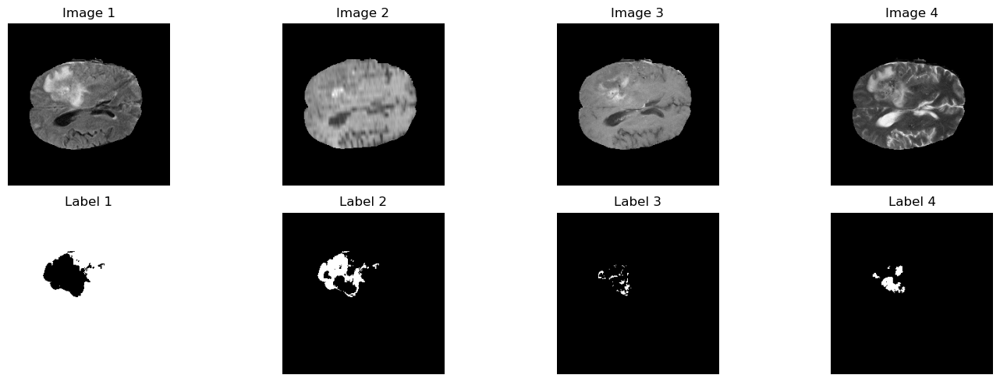

In [76]:
plot_images(train_features, train_labels, name_organ)

#### 2.2) Create dataset - Enhanced

In [77]:
# usage in a MONAI pipeline
from monai.transforms import Compose, Lambdad, ToTensord
from skimage.feature import canny

def canny_detector(image, k=1):
    # Initialize an empty array with the same shape as the input image
    img_edge = np.zeros_like(image)
    # Loop through each channel
    for c in range(image.shape[0]):
        # Loop through each slice in the depth dimension
        for i in range(image.shape[-1]):
            slice_2d = image[c, :, :, i]
            v = np.median(slice_2d)
            sigma = 0.33
            lower = int(max(0, (1.0 - sigma) * v))
            upper = int(min(255, (1.0 + sigma) * v))
            edges = cv2.Canny(cv2.convertScaleAbs(slice_2d), lower, upper)
            img_edge[c, :, :, i] = cv2.addWeighted(slice_2d.astype(np.float32), 1, cv2.convertScaleAbs(edges).astype(np.float32), k, 0)
    return img_edge
 

train_transform_en = Compose(
    [
        Lambdad(keys=["image"], func=canny_detector),  # Apply only Canny edge detection
        #AddChanneld(keys=["image", "label"]),
        #Spacingd(keys=['image', 'label'], pixdim=(1., 1., 1.), mode=("bilinear", "nearest")),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=0),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=1),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=2),
        #NormalizeIntensityd(keys='image', nonzero=True, channel_wise=True),
        RandScaleIntensityd(keys='image', factors=0.1, prob=1.0),
        RandShiftIntensityd(keys='image', offsets=0.1, prob=1.0),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)

val_transform_en = Compose(
    [
        # Lambdad(keys=["image"], func=canny_detector),  # Apply only Canny edge detection
        #ScaleIntensityd(keys="image"),  # Normalize intensity like in training
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=0),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=1),
        RandFlipd(keys=['image', 'label'], prob=0.5, spatial_axis=2),
        DivisiblePadd(k=16, keys=["image", "label"]), # pad the input data, so that the spatial sizes are divisible by k
        ToTensord(keys=['image', 'label'])
    ]
)

In [78]:
data_info_en = 'enhanced'

transforms_enhanced = [train_transform_en,val_transform_en]

In [79]:
# loads dataset and check for incomplate channels
# padding is added for the slices so it's divisible by 16

train_dataloader_en, val_dataloader_en, test_dataloader_en = get_train_val_test_dataloader2(list_tar_path[name_organ],list_json_file_name[name_organ],list_folder_name[name_organ], BATCH_SIZE = BATCH_SIZE, transforms=transforms_enhanced)

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Incomplete labels:  12 - Incomplete modality:  0
transform:  [<monai.transforms.compose.Compose object at 0x000002030420BC20>, <monai.transforms.compose.Compose object at 0x000002030B34BE90>]
Task01_BrainTumour/ 
Total training data:  53 
Total validation data:  17 
Total test data:  26 
----


In [80]:
train_features, train_labels = next(iter(train_dataloader_en))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)


Feature batch shape: torch.Size([1, 4, 240, 240, 160])
Labels batch shape: torch.Size([1, 4, 240, 240, 160])


torch.Size([1, 4, 240, 240, 160])


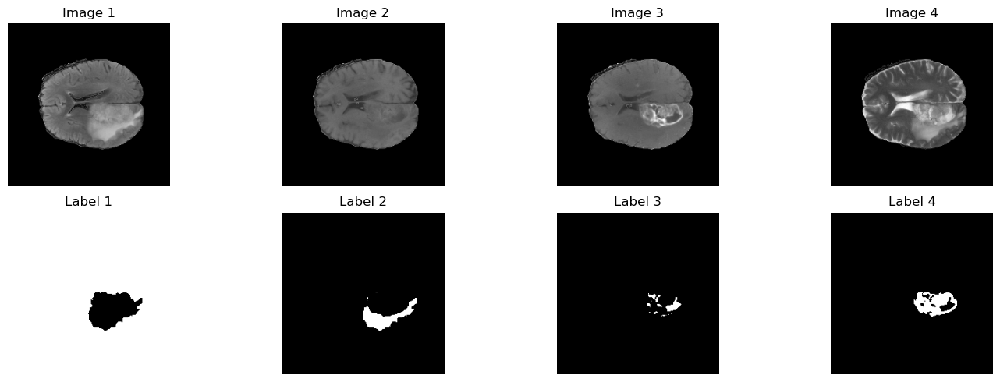

In [81]:
plot_images(train_features, train_labels, name_organ)

## 3) Modeling

In [82]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [83]:
DEVICE

'cuda'

In [84]:
# use amp to accelerate training
if DEVICE == 'cuda':
    #scaler = torch.cuda.amp.GradScaler() #
    scaler = torch.amp.GradScaler('cuda')

### 3.1) 3D U-Net

In [85]:
class conv_block(nn.Module):
    """
    The convolution block is for the double 3x3x3 convolutions each followed by a ReLU in the analysis & synthesis path
    -- __init__()
    :param inChannels -> number of input channels
    :param outChannels -> number of output channels
    -- forward()
    :param inputs -> input the Tensor to be convolved
    :return -> a Tensor
    """
    def __init__(self, inChannels, outChannels, double=True):
        super().__init__()
        # first convolution layer
        self.conv1 = nn.Conv3d(in_channels=inChannels, out_channels=outChannels, kernel_size=3, padding=1, bias=False)   #kernel size (3x3x3) # torch.nn.Conv3d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None)
        # batch normalization
        self.bn1 = nn.BatchNorm3d(outChannels)

        if double:
            # second convolution layer (doubles the output channel)
            self.conv2 = nn.Conv3d(in_channels=outChannels, out_channels=outChannels*2, kernel_size=3, padding=1, bias=False)   #kernel size (3x3x3)
            # batch normalization
            self.bn2 = nn.BatchNorm3d(outChannels*2)
        else:
            # second convolution layer
            self.conv2 = nn.Conv3d(in_channels=outChannels, out_channels=outChannels, kernel_size=3, padding=1, bias=False)   #kernel size (3x3x3)
            # batch normalization
            self.bn2 = nn.BatchNorm3d(outChannels)

        # ReLU
        self.relu = nn.ReLU()

    def forward(self, inputs):
        x = self.conv1(inputs)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x

class encoder_block(nn.Module):
    """
    The encoder block or analysis path is for the block convolution (double 3x3x3 conv) and a MaxPooling
    -- __init__()
    :param inChannels -> number of input channels
    :param outChannels -> number of output channels
    :param last_layer -> specifies the last layer of the block
    -- forward()
    :param inputs -> input the Tensor to be encoded
    :return -> a Tensor
    """
    def __init__(self, inChannels, outChannels, last_layer=False):
        super().__init__()

        self.conv = conv_block(inChannels, outChannels)
        self.last_layer = last_layer

        if not last_layer:
            self.pool = nn.MaxPool3d(kernel_size=2, stride=2)

    def forward(self, inputs):

        x = self.conv(inputs)
        p = None
        if not self.last_layer:
            p = self.pool(x)
        else:
            p = x
        # x: output of the conv_block
        # p: output of the pooling layer
        return x, p

class decoder_block(nn.Module):
    """
    The decoder block or synthesis path is for an Up convolution followed by the block convolution (double 3x3x3 conv)
    -- __init__()
    :param inChannels -> number of input channels
    :param outChannels -> number of output channels
    -- forward()
    :param inputs -> input the Tensor to be decoded
    :param skip -> the skip connection feature map
    :return -> a Tensor
    """
    def __init__(self, inChannels, outChannels):
        super().__init__()
        # up-convolution
        self.upconv = nn.ConvTranspose3d(in_channels=inChannels, out_channels= inChannels, kernel_size=2, stride=2, padding=(0, 0, 0))
        # convolution block
        self.conv = conv_block(inChannels+outChannels, outChannels, double=False)

    def forward(self, inputs, skip):
        x = self.upconv(inputs)

        # rearange padding - solves bug for different depth values
        #print('--',x.size(), skip.size())

        def pad_to_match(x, skip):
            """
            Pads the x tensor to match the shape of skip tensor.
            """
            if x.shape[-1] < skip.shape[-1]:
                padding = skip.shape[-1] - x.shape[-1]
                x = F.pad(x, (0, padding))  # Pad last dimension
            elif skip.shape[-1] < x.shape[-1]:
                padding = x.shape[-1] - skip.shape[-1]
                skip = F.pad(skip, (0, padding))
            return x, skip

        # Pad tensors to match
        x_padded, skip_padded = pad_to_match(x, skip)

        x = torch.cat([x_padded, skip_padded], axis=1)
        x = self.conv(x)

        return x

In [86]:
class UNet(Module):
    def __init__(self, inchannels, outchannels, channels = [32,64,128,256,512]):
        super(UNet, self).__init__()
        # initialize the encoder (analysis)
        self.encoder_1 = encoder_block(inchannels, channels[0] ) # in 3, out 32*2
        self.encoder_2 = encoder_block(channels[1], channels[1] ) # in 64, out 64*2
        self.encoder_3 = encoder_block(channels[2], channels[2] ) # in 128, out 128*2

        self.transition = encoder_block(channels[3], channels[3] , last_layer = True ) # in 256, out 256*2

        # initialize the decoder (synthesis)
        self.decoder_1 = decoder_block(channels[4], channels[3] ) # in 512, out 256
        self.decoder_2 = decoder_block(channels[3], channels[2] ) # in 256, out 128
        self.decoder_3 = decoder_block(channels[2], channels[1] )
        # initialize the regression head and store the class variables
        self.output = nn.Conv3d(channels[1], outchannels, kernel_size=1) # in 64, out number of classes


    def forward(self, inputs):
        # analysis path
        x1, out = self.encoder_1(inputs)
        x2, out = self.encoder_2(out)
        x3, out = self.encoder_3(out)

        _, out = self.transition(out)

        # synthesis path
        out = self.decoder_1(out, x3)
        out = self.decoder_2(out, x2)
        out = self.decoder_3(out, x1)

        out = self.output(out)

        return out

### 3.2) dRes-3D U-Net

In [87]:
import torch.nn.functional as F

class ResidualBlock(nn.Module):
    def __init__(self, inChannels, outChannels, double=True):
        super(ResidualBlock, self).__init__()
        # First convolution layer
        self.conv1 = nn.Conv3d(in_channels=inChannels, out_channels=outChannels, kernel_size=3, padding=1, bias=False)
        self.bn1 = nn.BatchNorm3d(outChannels)
        self.relu = nn.ReLU(inplace=True)

        # Second convolution layer
        if double:
            self.conv2 = nn.Conv3d(in_channels=outChannels, out_channels=outChannels*2, kernel_size=3, padding=1, bias=False)
            self.bn2 = nn.BatchNorm3d(outChannels*2)
            self.out_channels = outChannels*2
        else:
            self.conv2 = nn.Conv3d(in_channels=outChannels, out_channels=outChannels, kernel_size=3, padding=1, bias=False)
            self.bn2 = nn.BatchNorm3d(outChannels)
            self.out_channels = outChannels

        # Shortcut connection
        self.shortcut = nn.Sequential()
        if inChannels != self.out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv3d(inChannels, self.out_channels, kernel_size=1, stride=1, bias=False),
                nn.BatchNorm3d(self.out_channels)
            )

    def forward(self, inputs):
        residual = inputs

        out = self.relu(self.bn1(self.conv1(inputs)))
        out = self.bn2(self.conv2(out))

        # Add the residual connection
        out += self.shortcut(residual)
        out = self.relu(out)
        return out
    
class encoder_block_r(nn.Module):
    def __init__(self, inChannels, outChannels, last_layer=False):
        super().__init__()
        self.conv = ResidualBlock(inChannels, outChannels)
        self.last_layer = last_layer
        if not last_layer:
            self.pool = nn.MaxPool3d(kernel_size=2, stride=2)

    def forward(self, inputs):
        x = self.conv(inputs)
        p = None
        if not self.last_layer:
            p = self.pool(x)
        else:
            p = x
        return x, p

class decoder_block_r(nn.Module):
    def __init__(self, inChannels, outChannels):
        super().__init__()
        # Up-convolution
        self.upconv = nn.ConvTranspose3d(in_channels=inChannels, out_channels=inChannels, kernel_size=2, stride=2, padding=(0, 0, 0))
        # Residual block for convolution
        self.conv = ResidualBlock(inChannels + outChannels, outChannels, double=False)

    def forward(self, inputs, skip):
        x = self.upconv(inputs)
        
        def pad_to_match(x, skip):
            if x.shape[-1] < skip.shape[-1]:
                padding = skip.shape[-1] - x.shape[-1]
                x = F.pad(x, (0, padding))  # Pad last dimension
            elif skip.shape[-1] < x.shape[-1]:
                padding = x.shape[-1] - skip.shape[-1]
                skip = F.pad(skip, (0, padding))
            return x, skip

        x_padded, skip_padded = pad_to_match(x, skip)
        x = torch.cat([x_padded, skip_padded], axis=1)
        x = self.conv(x)
        return x

In [88]:
class dRes_UNet(Module):
    def __init__(self, inchannels, outchannels, channels=[32, 64, 128, 256, 512]):
        super(dRes_UNet, self).__init__()
        # Initialize the encoder (analysis)
        self.encoder_1 = encoder_block_r(inchannels, channels[0])
        self.encoder_2 = encoder_block_r(channels[1], channels[1])
        self.encoder_3 = encoder_block_r(channels[2], channels[2])

        self.transition = encoder_block_r(channels[3], channels[3], last_layer=True)

        # Initialize the decoder (synthesis)
        self.decoder_1 = decoder_block_r(channels[4], channels[3])
        self.decoder_2 = decoder_block_r(channels[3], channels[2])
        self.decoder_3 = decoder_block_r(channels[2], channels[1])
        
        # Initialize the regression head
        self.output = nn.Conv3d(channels[1], outchannels, kernel_size=1)

    def forward(self, inputs):
        # Analysis path
        x1, out = self.encoder_1(inputs)
        x2, out = self.encoder_2(out)
        x3, out = self.encoder_3(out)

        _, out = self.transition(out)

        # Synthesis path
        out = self.decoder_1(out, x3)
        out = self.decoder_2(out, x2)
        out = self.decoder_3(out, x1)

        out = self.output(out)

        return out

### 3.2) Configure

In [89]:
# Instantiate the model

# Input channel & Number of output classes (segmentation labels)
if name_organ == 'heart':
    in_channels= 1 
    out_classes= 2 #(background,mask)
if name_organ == 'prostate':
    in_channels= 2
    out_classes= 3
if name_organ == 'brain':
    in_channels = 4
    out_classes = 4

#channels = [16,32,64,128,256]
channels = [8,16,32,64,128]
#channels = [4,8,16,32,64]

In [90]:
model = UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)

In [91]:
#from torchview import draw_graph
#model_graph = draw_graph(model, input_size=(1, 2, 320, 320, 16), expand_nested=True, depth=1)
#model_graph.visual_graph

In [92]:
model

UNet(
  (encoder_1): encoder_block(
    (conv): conv_block(
      (conv1): Conv3d(4, 8, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn1): BatchNorm3d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv3d(8, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn2): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (pool): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (encoder_2): encoder_block(
    (conv): conv_block(
      (conv1): Conv3d(16, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn1): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv3d(16, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn2): BatchNorm3d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stat

In [93]:
#backbone = EfficientNet3D(name="efficientnet_b0")
model_2 = dRes_UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)

In [97]:
#from torchview import draw_graph
#model_graph = draw_graph(model_2, input_size=(1, 2, 320, 320, 16), expand_nested=True, depth=1)
#model_graph.visual_graph

In [98]:
# get total number of parameters
pytorch_total_params = sum(p.numel() for p in model.parameters())

print('UNet - Total number of parameters: ', pytorch_total_params)

print('UNet - Total number of parameters: ', sum(p.numel() for p in model_2.parameters()))

UNet - Total number of parameters:  1193876
UNet - Total number of parameters:  1221524


## 4) Train model

- Configuration

In [99]:
#torch.cuda.empty_cache()

In [100]:
# epochs
NUM_EPOCHS = 50

In [101]:
!nvidia-smi

Fri Feb 14 09:24:05 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 566.03                 Driver Version: 566.03         CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4060      WDDM  |   00000000:01:00.0  On |                  N/A |
|  0%   33C    P8             N/A /  115W |    1186MiB /   8188MiB |      8%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [102]:
def memory_stats():
    print(torch.cuda.memory_allocated()/1024**2)
    print(torch.cuda.memory_reserved()/1024**2)

In [103]:
memory_stats()

9.291015625
28.0


In [104]:
def calculate_volumetric_similarity(outputs, ground_truth):
    """
    VS closer to 1 → Better segmentation agreement
    VS closer to 0 → Poor segmentation agreement
    VS can be 1 even if there is no overlap! (This is a weakness of the metric—it only compares volumes, not spatial alignment.)
    """   
    outputs_bin = torch.argmax(outputs, dim=1)  # Convert softmax probabilities to discrete labels    
    TP = torch.sum((outputs_bin == 1) & (ground_truth == 1)).item()     
    FP = torch.sum((outputs_bin == 1) & (ground_truth == 0)).item()     
    FN = torch.sum((outputs_bin == 0) & (ground_truth == 1)).item()     
    return 1 - abs(FN - FP) / (2 * TP + FP + FN + 1e-8) # Avoid division by zero

In [105]:
import torch
import os
 
def save_checkpoint(model, optimizer, scaler, epoch, history,startime, checkpoint_dir='checkpoints', filename='checkpoint.pth'):
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)
    checkpoint_path = os.path.join(checkpoint_dir, filename)
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scaler_state_dict': scaler.state_dict() if scaler else None,
        'history': history,
        'start_time': startime
    }, checkpoint_path)
    print(f"Checkpoint saved at {checkpoint_path}")
 
def train_model(model, name_organ, data_info, train_dataloader, val_dataloader, out_classes, NUM_EPOCHS=30, BATCH_SIZE=1, lr=0.001, b=(0.9, 0.999), resume_from_checkpoint=False, checkpoint_dir=PATH+'checkpoints', checkpoint_filename='checkpoint.pth'):
 
    print(DEVICE)
    # use amp to accelerate training
    scaler = torch.amp.GradScaler('cuda') if DEVICE == 'cuda' else None #torch.cuda.amp.GradScaler() if DEVICE == 'cuda' else None
 
    epoch_loss_values = []
 
    best_metric_dice = -1
    best_metric_epoch_dice = -1
 
    best_metric_jaccard = -1
    best_metric_epoch_jaccard = -1
 
    best_metric_vs = -1
    best_metric_epoch_vs = -1
 
    metric_values_dice = []
    metric_values_labels_dice = []
    best_metrics_epochs_and_time_dice = [[], [], []]
 
    metric_values_jaccard = []
    metric_values_labels_jaccard = []
    best_metrics_epochs_and_time_jaccard = [[], [], []]
 
    metric_values_vs = []
    best_metrics_epochs_and_time_vs = [[], [], []]
 
    # calculate steps per epoch for training and test set
    trainSteps = len(train_dataloader) // BATCH_SIZE
    testSteps = len(val_dataloader) // BATCH_SIZE
 
    # loss and optimizer
    criterion = nn.CrossEntropyLoss()
    #criterion = DiceCELoss(to_onehot_y=False, softmax=False, include_background=True)
    optimizer = torch.optim.Adam(params=model.parameters(), lr=lr, betas=b, weight_decay=1e-4)#1e-5)
 
    # define post-processing transforms
    #post_trans = Compose([Activations(softmax=True, dim=1), AsDiscrete(threshold=0.5)])
    #post_pred = Compose([AsDiscrete(argmax=True, to_onehot=2)])
    #make_2_class = Compose([AsDiscrete(argmax=True, to_onehot=2), lambda x: x[None]])
    #make_2_class = Compose([AsDiscrete(argmax=True, to_onehot=out_classes)]) #, n_classes=out_classes)])
    # make one hot and add batch dimension
 
    # Initialize ReduceLROnPlateau scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)
 
    # metrics
    dice_metric = DiceMetric(include_background=True, reduction="mean")
    dice_metric_batch = DiceMetric(include_background=True, reduction="mean_batch")
    jaccard_metric = MeanIoU(include_background=True, reduction="mean")
    jaccard_metric_batch = MeanIoU(include_background=True, reduction="mean_batch")
 
    # store training history
    history = {"train_loss": [], "val_loss": [], 'metric_dice': [], 'metric_jaccard': [], "metric_vs": [], "lr": []}
 
    start_epoch = 0
 
    # Load checkpoint if needed
    if resume_from_checkpoint:
        print('...from checkpoint')
        print(checkpoint_dir)
        checkpoint_path = os.path.join(checkpoint_dir, checkpoint_filename)
        if os.path.isfile(checkpoint_path):
            checkpoint = torch.load(checkpoint_path)
            model.load_state_dict(checkpoint['model_state_dict'])
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            if scaler and checkpoint['scaler_state_dict']:
                scaler.load_state_dict(checkpoint['scaler_state_dict'])
            start_epoch = checkpoint['epoch'] + 1
            history = checkpoint['history']
            startTime = checkpoint['start_time']
            print(f"Resumed from checkpoint: {checkpoint_path}, epoch {start_epoch}, history {len(history)}")
        else:
            print(f"No checkpoint found at: {checkpoint_path}")
    else:
      # record time
      startTime = time.time()
 
    for epoch in tqdm(range(start_epoch, NUM_EPOCHS), desc="epochs", position=0, total=NUM_EPOCHS):
    #for epoch in range(start_epoch, NUM_EPOCHS):
 
        # initialize the total training and validation loss
        total_TrainLoss = 0
        total_ValLoss = 0
 
        # set training mode of the model
        #print('Training...')
        model.train()
 
        # training loop
        for i,(images, ground_truth) in enumerate(train_dataloader):#tqdm(train_dataloader, desc="Training loop", position=1, leave=False, total=(len(train_dataloader)-incomplete_labels)):
 
            (images, ground_truth) = (images.to(DEVICE), ground_truth.to(DEVICE))
 
            # avoid incomplete labels
            if ground_truth.shape[1] != out_classes:
                #print('img:',images.shape,'lab: ',ground_truth.shape)
                #print('...jump next iteration...')
                continue
 
            if DEVICE == 'cuda':
                optimizer.zero_grad() # zero out any previously accumulated gradients
 
                with torch.amp.autocast('cuda'):
                    # Forward pass
                    outputs = model(images)
                    #outputs = torch.softmax(outputs, dim=1)
 
                    # Loss function
                    loss = criterion(outputs, ground_truth)
 
                #torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                # Back propagation and optimize (update)
                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()
 
            else:
                    # Forward pass
                    outputs = model(images)
                    #outputs = torch.softmax(outputs, dim=1)
                    # Loss function
                    loss = criterion(outputs, ground_truth)
                    # Back propagation and optimize (update)
                    optimizer.zero_grad() # zero out any previously accumulated gradients
                    loss.backward()
                    optimizer.step()
 
            # add the loss to the total training loss
            total_TrainLoss += loss
 
        # set evaluation mode of the model
        #print('Validating...')
        model.eval()
        with torch.no_grad():
            for i, (images, ground_truth) in enumerate(val_dataloader):#tqdm(val_dataloader, desc="Validating loop", position=2, leave=False, total=len(val_dataloader)):
                (images, ground_truth) = (images.to(DEVICE), ground_truth.to(DEVICE))
 
                # Forward pass - make the predictions
                outputs = model(images)
                # Loss function
                loss = criterion(outputs, ground_truth)
                # add the loss to the total validation loss
                total_ValLoss += loss
 
                # post-processing
                outputs = torch.softmax(outputs, dim=1) # Convert logits to probabilities
 
                #outputs = make_2_class(outputs) # to onehot
                outputs_dice = torch.argmax(outputs, dim=1, keepdim=True)  # Get class indices
                outputs_dice = one_hot(outputs_dice, num_classes=out_classes)  # Convert to one-hot
                #ground_truth2 = make_2_class(ground_truth) # to onehot
 
                # metrics
                dice_metric(y_pred=outputs_dice, y=ground_truth)
                dice_metric_batch(y_pred=outputs_dice, y=ground_truth)
               
                jaccard_metric(y_pred=outputs, y=ground_truth)
                jaccard_metric_batch(y_pred=outputs, y=ground_truth)
               
                VS = calculate_volumetric_similarity(outputs, ground_truth)
                metric_values_vs.append(VS)
 
 
            # save DICE metrics
            metric_1 = dice_metric.aggregate().detach().cpu().item()
            metric_values_dice.append(metric_1)
 
            metric_batch = dice_metric_batch.aggregate()
            metric_values_labels_dice.append( [m.item() for m in metric_batch] )
 
            dice_metric.reset()
            dice_metric_batch.reset()
 
            if metric_1 > best_metric_dice:
                best_metric_dice = metric_1
                best_metric_epoch_dice  = epoch + 1
                best_metrics_epochs_and_time_dice[0].append(best_metric_dice)
                best_metrics_epochs_and_time_dice[1].append(best_metric_epoch_dice )
                best_metrics_epochs_and_time_dice[2].append(time.time() - startTime)
                torch.save(
                    model.state_dict(),
                    os.path.join(PATH, f"best_metric_model_dice_{name_organ}_{data_info}.pth"),
                )
                print(
                    #f"current epoch: {epoch + 1} - current mean dice: {metric_1:.4f}"
                    f"- best mean dice: {best_metric_dice:.4f}"
                    f" at epoch: {best_metric_epoch_dice }")
 
            # save JACCARD metrics
            metric_2 = jaccard_metric.aggregate().detach().cpu().item()
            metric_values_jaccard.append(metric_2)
 
            metric_batch = jaccard_metric_batch.aggregate()
            metric_values_labels_jaccard.append( [m.detach().cpu().item() for m in metric_batch] )
 
            jaccard_metric.reset()
            jaccard_metric_batch.reset()
 
            if metric_2 > best_metric_jaccard:
                best_metric_jaccard = metric_2
                best_metric_epoch_jaccard  = epoch + 1
                best_metrics_epochs_and_time_jaccard[0].append(best_metric_jaccard)
                best_metrics_epochs_and_time_jaccard[1].append(best_metric_epoch_jaccard )
                best_metrics_epochs_and_time_jaccard[2].append(time.time() - startTime)
                torch.save(
                    model.state_dict(),
                    os.path.join(PATH, f"best_metric_model_jaccard_{name_organ}_{data_info}.pth"),
                )
                print(
                    #f"current epoch: {epoch + 1} - current mean jaccard: {metric_2:.4f}"
                    f"- best mean jaccard: {best_metric_jaccard:.4f}"
                    f" at epoch: {best_metric_epoch_jaccard}")
 
            metric_3 = sum(metric_values_vs) / len(metric_values_vs)
            history["metric_vs"].append(metric_3)
 
        # calculate the average training and validation loss
        avg_TrainLoss = total_TrainLoss / trainSteps
        avg_ValLoss = total_ValLoss / testSteps
 
        # update training history
        history["train_loss"].append(avg_TrainLoss.cpu().detach().numpy())
        history["val_loss"].append(avg_ValLoss.cpu().detach().numpy())
        history["metric_dice"].append([metric_values_dice, metric_values_labels_dice, best_metrics_epochs_and_time_dice])
        history["metric_jaccard"].append([metric_values_jaccard, metric_values_labels_jaccard, best_metrics_epochs_and_time_jaccard])
        history["lr"].append(optimizer.param_groups[0]['lr'])
 
        # print the model training and validation information
        print ('Epoch [{}/{}], Loss: {:.4f}'.format(epoch+1, NUM_EPOCHS, loss.item()),
               "-  Train loss: {:.6f}, Validation loss: {:.4f}".format(avg_TrainLoss, avg_ValLoss))
 
        scheduler.step(avg_ValLoss)
 
        # Save checkpoint every epoch (you can also choose to save every few epochs or based on a condition)
        save_checkpoint(model, optimizer, scaler, epoch, history, startTime, checkpoint_dir, checkpoint_filename)
 
        del total_TrainLoss
        del avg_TrainLoss
 
    # display the total time needed to perform the training
    endTime = time.time()
    print("Time taken to train the model: {:.2f}s".format(endTime - startTime))
 
    return model, history

In [106]:
lr=0.0005

### 3DUNet

#### Training - Raw

In [107]:
data_info = 'raw'
model = UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)
mdl, history = train_model(model, name_organ, data_info, train_dataloader, val_dataloader, out_classes, NUM_EPOCHS, BATCH_SIZE=BATCH_SIZE, lr=lr)

c:\Users\Usuario\anaconda3\envs\pytorch_env\Lib\site-packages\torch\optim\lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


cuda


epochs:   0%|          | 0/50 [00:00<?, ?it/s]

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3488\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
epochs:   2%|▏         | 1/50 [07:27<6:05:46, 447.89s/it]

- best mean dice: 0.2468 at epoch: 1
- best mean jaccard: 0.1098 at epoch: 1
Epoch [1/50], Loss: 0.7664 -  Train loss: 1.011236, Validation loss: 1.0720
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   4%|▍         | 2/50 [15:02<6:01:37, 452.03s/it]

- best mean dice: 0.2525 at epoch: 2
- best mean jaccard: 0.1327 at epoch: 2
Epoch [2/50], Loss: 0.8908 -  Train loss: 0.673956, Validation loss: 0.7125
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   4%|▍         | 2/50 [22:44<9:05:39, 682.07s/it]


KeyboardInterrupt: 

In [ ]:
  # start from checkpoint
  #mdl, history = train_model(model,name_organ, train_dataloader, val_dataloader, out_classes, NUM_EPOCHS, BATCH_SIZE=BATCH_SIZE, lr=0.001, resume_from_checkpoint=True)

##### Save results

In [ ]:
import datetime
date_time = datetime.datetime.now().strftime("%Y-%m-%d")

# Save the model state dictionary
torch.save(mdl.state_dict(), PATH+ f'unet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{date_time}.pth')
# Save all
torch.save(mdl, PATH + f"unet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{date_time}.pt")
# save history
import pickle
with open(PATH + f"unet_history_v10_1M_{name_organ}_{data_info}_{date_time}", "wb") as fp:   #Pickling
   pickle.dump(history, fp)

#### Training - Enhanced

In [85]:
model_en = UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)
mdl_en, history_en = train_model(model_en, name_organ, data_info_en, train_dataloader_en, val_dataloader_en, out_classes, NUM_EPOCHS, BATCH_SIZE=BATCH_SIZE, lr=lr)

cuda


epochs:   0%|          | 0/50 [00:00<?, ?it/s]C:\Users\Usuario\AppData\Local\Temp\ipykernel_5372\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
epochs:   2%|▏         | 1/50 [00:11<09:43, 11.90s/it]

- best mean dice: 0.3153 at epoch: 1
- best mean jaccard: 0.1329 at epoch: 1
Epoch [1/50], Loss: 0.5159 -  Train loss: 0.803916, Validation loss: 0.5460
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   4%|▍         | 2/50 [00:23<09:26, 11.80s/it]

- best mean dice: 0.3339 at epoch: 2
- best mean jaccard: 0.1429 at epoch: 2
Epoch [2/50], Loss: 0.4785 -  Train loss: 0.616606, Validation loss: 0.5034
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   6%|▌         | 3/50 [00:35<09:13, 11.78s/it]

- best mean jaccard: 0.1487 at epoch: 3
Epoch [3/50], Loss: 0.4694 -  Train loss: 0.544874, Validation loss: 0.4956
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   8%|▊         | 4/50 [00:47<09:03, 11.81s/it]

- best mean dice: 0.3344 at epoch: 4
- best mean jaccard: 0.1665 at epoch: 4
Epoch [4/50], Loss: 0.4461 -  Train loss: 0.494776, Validation loss: 0.4259
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  10%|█         | 5/50 [00:59<08:57, 11.95s/it]

- best mean jaccard: 0.1691 at epoch: 5
Epoch [5/50], Loss: 0.4978 -  Train loss: 0.447580, Validation loss: 0.4460
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  12%|█▏        | 6/50 [01:11<08:42, 11.88s/it]

- best mean dice: 0.3506 at epoch: 6
- best mean jaccard: 0.1885 at epoch: 6
Epoch [6/50], Loss: 0.3058 -  Train loss: 0.402976, Validation loss: 0.3361
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  14%|█▍        | 7/50 [01:22<08:28, 11.84s/it]

- best mean jaccard: 0.1957 at epoch: 7
Epoch [7/50], Loss: 0.2826 -  Train loss: 0.366236, Validation loss: 0.3093
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  16%|█▌        | 8/50 [01:34<08:14, 11.77s/it]

- best mean jaccard: 0.2100 at epoch: 8
Epoch [8/50], Loss: 0.3773 -  Train loss: 0.335035, Validation loss: 0.2646
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  18%|█▊        | 9/50 [01:46<08:00, 11.72s/it]

- best mean jaccard: 0.2251 at epoch: 9
Epoch [9/50], Loss: 0.2293 -  Train loss: 0.301506, Validation loss: 0.2132
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  20%|██        | 10/50 [01:57<07:48, 11.71s/it]

- best mean dice: 0.3545 at epoch: 10
Epoch [10/50], Loss: 0.2359 -  Train loss: 0.271715, Validation loss: 0.2095
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  22%|██▏       | 11/50 [02:09<07:36, 11.71s/it]

Epoch [11/50], Loss: 0.2522 -  Train loss: 0.246098, Validation loss: 0.2241
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  24%|██▍       | 12/50 [02:21<07:24, 11.71s/it]

- best mean jaccard: 0.2314 at epoch: 12
Epoch [12/50], Loss: 0.2562 -  Train loss: 0.226863, Validation loss: 0.2536
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  26%|██▌       | 13/50 [02:33<07:13, 11.71s/it]

- best mean jaccard: 0.2455 at epoch: 13
Epoch [13/50], Loss: 0.1862 -  Train loss: 0.205762, Validation loss: 0.1640
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  28%|██▊       | 14/50 [02:44<07:02, 11.74s/it]

Epoch [14/50], Loss: 0.1387 -  Train loss: 0.185733, Validation loss: 0.1593
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  30%|███       | 15/50 [02:56<06:51, 11.76s/it]

- best mean jaccard: 0.2556 at epoch: 15
Epoch [15/50], Loss: 0.1232 -  Train loss: 0.168216, Validation loss: 0.1387
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  32%|███▏      | 16/50 [03:08<06:39, 11.75s/it]

- best mean jaccard: 0.2570 at epoch: 16
Epoch [16/50], Loss: 0.1623 -  Train loss: 0.153645, Validation loss: 0.1243
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  34%|███▍      | 17/50 [03:20<06:27, 11.75s/it]

- best mean jaccard: 0.2678 at epoch: 17
Epoch [17/50], Loss: 0.1037 -  Train loss: 0.141995, Validation loss: 0.1265
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  36%|███▌      | 18/50 [03:31<06:16, 11.76s/it]

Epoch [18/50], Loss: 0.0959 -  Train loss: 0.130229, Validation loss: 0.1160
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  38%|███▊      | 19/50 [03:43<06:04, 11.76s/it]

- best mean jaccard: 0.2681 at epoch: 19
Epoch [19/50], Loss: 0.1037 -  Train loss: 0.121383, Validation loss: 0.1011
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  40%|████      | 20/50 [03:55<05:52, 11.76s/it]

Epoch [20/50], Loss: 0.3108 -  Train loss: 0.115785, Validation loss: 0.1934
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  42%|████▏     | 21/50 [04:07<05:41, 11.79s/it]

Epoch [21/50], Loss: 0.0695 -  Train loss: 0.107280, Validation loss: 0.1030
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  44%|████▍     | 22/50 [04:19<05:29, 11.78s/it]

- best mean jaccard: 0.2829 at epoch: 22
Epoch [22/50], Loss: 0.0551 -  Train loss: 0.101980, Validation loss: 0.0761
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  46%|████▌     | 23/50 [04:30<05:17, 11.77s/it]

Epoch [23/50], Loss: 0.6032 -  Train loss: 0.098109, Validation loss: 0.1959
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  48%|████▊     | 24/50 [04:42<05:05, 11.76s/it]

Epoch [24/50], Loss: 0.1615 -  Train loss: 0.094180, Validation loss: 0.2619
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  50%|█████     | 25/50 [04:54<04:53, 11.74s/it]

Epoch [25/50], Loss: 0.0901 -  Train loss: 0.088291, Validation loss: 0.0811
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  52%|█████▏    | 26/50 [05:05<04:41, 11.73s/it]

Epoch [26/50], Loss: 0.0538 -  Train loss: 0.084249, Validation loss: 0.0971
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  54%|█████▍    | 27/50 [05:17<04:29, 11.72s/it]

Epoch [27/50], Loss: 0.0783 -  Train loss: 0.083806, Validation loss: 0.0932
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  56%|█████▌    | 28/50 [05:29<04:18, 11.73s/it]

- best mean jaccard: 0.2841 at epoch: 28
Epoch [28/50], Loss: 0.0568 -  Train loss: 0.076731, Validation loss: 0.0716
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  58%|█████▊    | 29/50 [05:41<04:06, 11.76s/it]

Epoch [29/50], Loss: 0.1870 -  Train loss: 0.073375, Validation loss: 0.0913
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  60%|██████    | 30/50 [05:52<03:54, 11.73s/it]

- best mean jaccard: 0.2953 at epoch: 30
Epoch [30/50], Loss: 0.0483 -  Train loss: 0.071366, Validation loss: 0.0608
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  62%|██████▏   | 31/50 [06:04<03:42, 11.72s/it]

Epoch [31/50], Loss: 0.0651 -  Train loss: 0.068880, Validation loss: 0.0553
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  64%|██████▍   | 32/50 [06:16<03:30, 11.69s/it]

Epoch [32/50], Loss: 0.0983 -  Train loss: 0.066970, Validation loss: 0.1070
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  66%|██████▌   | 33/50 [06:27<03:18, 11.70s/it]

- best mean jaccard: 0.3006 at epoch: 33
Epoch [33/50], Loss: 0.0339 -  Train loss: 0.065166, Validation loss: 0.0559
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  68%|██████▊   | 34/50 [06:39<03:07, 11.70s/it]

Epoch [34/50], Loss: 0.0689 -  Train loss: 0.057658, Validation loss: 0.0592
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  70%|███████   | 35/50 [06:51<02:55, 11.72s/it]

- best mean dice: 0.3654 at epoch: 35
Epoch [35/50], Loss: 0.0743 -  Train loss: 0.055236, Validation loss: 0.0741
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  72%|███████▏  | 36/50 [07:03<02:44, 11.74s/it]

Epoch [36/50], Loss: 0.0389 -  Train loss: 0.051385, Validation loss: 0.0466
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  74%|███████▍  | 37/50 [07:14<02:32, 11.72s/it]

Epoch [37/50], Loss: 0.0779 -  Train loss: 0.049670, Validation loss: 0.0650
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  76%|███████▌  | 38/50 [07:26<02:20, 11.70s/it]

Epoch [38/50], Loss: 0.1273 -  Train loss: 0.048457, Validation loss: 0.1769
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  78%|███████▊  | 39/50 [07:38<02:08, 11.72s/it]

Epoch [39/50], Loss: 0.0877 -  Train loss: 0.047360, Validation loss: 0.1070
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  80%|████████  | 40/50 [07:49<01:57, 11.73s/it]

Epoch [40/50], Loss: 0.0286 -  Train loss: 0.044421, Validation loss: 0.0452
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  82%|████████▏ | 41/50 [08:01<01:45, 11.75s/it]

- best mean dice: 0.3917 at epoch: 41
- best mean jaccard: 0.3071 at epoch: 41
Epoch [41/50], Loss: 0.0279 -  Train loss: 0.042399, Validation loss: 0.0431
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  84%|████████▍ | 42/50 [08:13<01:33, 11.74s/it]

Epoch [42/50], Loss: 0.0250 -  Train loss: 0.041210, Validation loss: 0.0377
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  86%|████████▌ | 43/50 [08:25<01:22, 11.76s/it]

Epoch [43/50], Loss: 0.0307 -  Train loss: 0.041280, Validation loss: 0.0479
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  88%|████████▊ | 44/50 [08:37<01:10, 11.76s/it]

- best mean dice: 0.4026 at epoch: 44
- best mean jaccard: 0.3080 at epoch: 44
Epoch [44/50], Loss: 0.0444 -  Train loss: 0.041449, Validation loss: 0.0470
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  90%|█████████ | 45/50 [08:48<00:58, 11.73s/it]

Epoch [45/50], Loss: 0.0789 -  Train loss: 0.039774, Validation loss: 0.1061
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  92%|█████████▏| 46/50 [09:00<00:47, 11.76s/it]

Epoch [46/50], Loss: 0.0854 -  Train loss: 0.037480, Validation loss: 0.0404
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  94%|█████████▍| 47/50 [09:12<00:35, 11.74s/it]

Epoch [47/50], Loss: 0.0603 -  Train loss: 0.037195, Validation loss: 0.0458
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  96%|█████████▌| 48/50 [09:23<00:23, 11.71s/it]

Epoch [48/50], Loss: 0.1425 -  Train loss: 0.037893, Validation loss: 0.0695
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  98%|█████████▊| 49/50 [09:35<00:11, 11.71s/it]

Epoch [49/50], Loss: 0.0235 -  Train loss: 0.036829, Validation loss: 0.0367
Checkpoint saved at checkpoints\checkpoint.pth


epochs: 100%|██████████| 50/50 [09:47<00:00, 11.74s/it]

Epoch [50/50], Loss: 0.0292 -  Train loss: 0.034324, Validation loss: 0.0364
Checkpoint saved at checkpoints\checkpoint.pth
Time taken to train the model: 587.25s


##### Save results

In [87]:
# Save the model state dictionary
torch.save(mdl_en.state_dict(), PATH+ f'unet_model_v10_lr0-0005_1M_{name_organ}_{data_info_en}_{date_time}.pth')

# Save all
torch.save(mdl_en, PATH + f"unet_model_v10_lr0-0005_1M_{name_organ}_{data_info_en}_{date_time}.pt")

# save history
import pickle
with open(PATH + f"unet_history_v10_1M_{name_organ}_{data_info_en}_{date_time}", "wb") as fp:   #Pickling
   pickle.dump(history_en, fp)

### dRes3DUNet

#### Training - Raw

In [88]:
data_info = 'raw'
model_2 = dRes_UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)
mdl_2, history_2 = train_model(model_2, name_organ, data_info, train_dataloader, val_dataloader, out_classes, NUM_EPOCHS, BATCH_SIZE=BATCH_SIZE, lr=lr)

cuda


epochs:   0%|          | 0/50 [00:00<?, ?it/s]C:\Users\Usuario\AppData\Local\Temp\ipykernel_24908\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
epochs:   2%|▏         | 1/50 [00:11<09:33, 11.71s/it]

- best mean dice: 0.2522 at epoch: 1
- best mean jaccard: 0.1654 at epoch: 1
Epoch [1/50], Loss: 0.3173 -  Train loss: 0.321301, Validation loss: 0.3334
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   4%|▍         | 2/50 [00:23<09:21, 11.69s/it]

- best mean dice: 0.3424 at epoch: 2
- best mean jaccard: 0.2361 at epoch: 2
Epoch [2/50], Loss: 0.1508 -  Train loss: 0.177866, Validation loss: 0.1297
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   6%|▌         | 3/50 [00:35<09:09, 11.69s/it]

- best mean dice: 0.3839 at epoch: 3
- best mean jaccard: 0.2496 at epoch: 3
Epoch [3/50], Loss: 0.1450 -  Train loss: 0.124755, Validation loss: 0.1128
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   8%|▊         | 4/50 [00:46<08:58, 11.72s/it]

- best mean dice: 0.4759 at epoch: 4
- best mean jaccard: 0.2665 at epoch: 4
Epoch [4/50], Loss: 0.1055 -  Train loss: 0.101259, Validation loss: 0.1147
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  10%|█         | 5/50 [00:58<08:51, 11.81s/it]

- best mean dice: 0.5301 at epoch: 5
- best mean jaccard: 0.2791 at epoch: 5
Epoch [5/50], Loss: 0.0559 -  Train loss: 0.079919, Validation loss: 0.0644
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  12%|█▏        | 6/50 [01:10<08:38, 11.78s/it]

- best mean jaccard: 0.2799 at epoch: 6
Epoch [6/50], Loss: 0.1183 -  Train loss: 0.068036, Validation loss: 0.0633
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  14%|█▍        | 7/50 [01:22<08:25, 11.75s/it]

Epoch [7/50], Loss: 0.0566 -  Train loss: 0.061582, Validation loss: 0.0562
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  16%|█▌        | 8/50 [01:33<08:12, 11.72s/it]

Epoch [8/50], Loss: 0.0394 -  Train loss: 0.054179, Validation loss: 0.0859
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  18%|█▊        | 9/50 [01:45<08:00, 11.71s/it]

Epoch [9/50], Loss: 0.0935 -  Train loss: 0.049711, Validation loss: 0.0482
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  20%|██        | 10/50 [01:57<07:49, 11.73s/it]

- best mean jaccard: 0.2913 at epoch: 10
Epoch [10/50], Loss: 0.0554 -  Train loss: 0.044661, Validation loss: 0.0794
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  22%|██▏       | 11/50 [02:08<07:35, 11.69s/it]

Epoch [11/50], Loss: 0.1276 -  Train loss: 0.042070, Validation loss: 0.1280
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  24%|██▍       | 12/50 [02:20<07:23, 11.68s/it]

Epoch [12/50], Loss: 0.0556 -  Train loss: 0.043736, Validation loss: 0.0416
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  26%|██▌       | 13/50 [02:32<07:11, 11.67s/it]

Epoch [13/50], Loss: 0.0346 -  Train loss: 0.036748, Validation loss: 0.0456
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  28%|██▊       | 14/50 [02:43<06:59, 11.67s/it]

Epoch [14/50], Loss: 0.0682 -  Train loss: 0.038275, Validation loss: 0.0490
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  30%|███       | 15/50 [02:55<06:48, 11.68s/it]

- best mean jaccard: 0.3036 at epoch: 15
Epoch [15/50], Loss: 0.0296 -  Train loss: 0.034653, Validation loss: 0.0342
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  32%|███▏      | 16/50 [03:07<06:37, 11.70s/it]

Epoch [16/50], Loss: 0.0180 -  Train loss: 0.031942, Validation loss: 0.0374
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  34%|███▍      | 17/50 [03:19<06:25, 11.69s/it]

Epoch [17/50], Loss: 0.0173 -  Train loss: 0.030937, Validation loss: 0.0373
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  36%|███▌      | 18/50 [03:30<06:13, 11.68s/it]

Epoch [18/50], Loss: 0.0332 -  Train loss: 0.030793, Validation loss: 0.0341
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  38%|███▊      | 19/50 [03:42<06:01, 11.67s/it]

Epoch [19/50], Loss: 0.0342 -  Train loss: 0.028692, Validation loss: 0.0362
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  40%|████      | 20/50 [03:53<05:49, 11.66s/it]

Epoch [20/50], Loss: 0.0325 -  Train loss: 0.031594, Validation loss: 0.0586
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  42%|████▏     | 21/50 [04:05<05:38, 11.68s/it]

Epoch [21/50], Loss: 0.0155 -  Train loss: 0.028682, Validation loss: 0.0380
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  44%|████▍     | 22/50 [04:17<05:28, 11.74s/it]

Epoch [22/50], Loss: 0.0317 -  Train loss: 0.029223, Validation loss: 0.1115
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  46%|████▌     | 23/50 [04:29<05:17, 11.76s/it]

Epoch [23/50], Loss: 0.0894 -  Train loss: 0.026328, Validation loss: 0.0350
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  48%|████▊     | 24/50 [04:41<05:05, 11.75s/it]

Epoch [24/50], Loss: 0.0133 -  Train loss: 0.025886, Validation loss: 0.0311
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  50%|█████     | 25/50 [04:52<04:52, 11.72s/it]

Epoch [25/50], Loss: 0.0276 -  Train loss: 0.024389, Validation loss: 0.0296
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  52%|█████▏    | 26/50 [05:04<04:41, 11.73s/it]

Epoch [26/50], Loss: 0.0116 -  Train loss: 0.025032, Validation loss: 0.0293
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  54%|█████▍    | 27/50 [05:16<04:29, 11.71s/it]

Epoch [27/50], Loss: 0.1304 -  Train loss: 0.024073, Validation loss: 0.0611
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  56%|█████▌    | 28/50 [05:27<04:16, 11.67s/it]

Epoch [28/50], Loss: 0.0232 -  Train loss: 0.022680, Validation loss: 0.1180
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  58%|█████▊    | 29/50 [05:39<04:04, 11.66s/it]

Epoch [29/50], Loss: 0.0274 -  Train loss: 0.022746, Validation loss: 0.0354
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  60%|██████    | 30/50 [05:50<03:52, 11.63s/it]

Epoch [30/50], Loss: 0.1019 -  Train loss: 0.022570, Validation loss: 0.0336
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  62%|██████▏   | 31/50 [06:02<03:41, 11.64s/it]

Epoch [31/50], Loss: 0.0130 -  Train loss: 0.022271, Validation loss: 0.0288
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  64%|██████▍   | 32/50 [06:14<03:29, 11.64s/it]

Epoch [32/50], Loss: 0.1403 -  Train loss: 0.022268, Validation loss: 0.1511
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  66%|██████▌   | 33/50 [06:25<03:18, 11.66s/it]

Epoch [33/50], Loss: 0.0130 -  Train loss: 0.021063, Validation loss: 0.0312
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  68%|██████▊   | 34/50 [06:37<03:06, 11.67s/it]

Epoch [34/50], Loss: 0.0133 -  Train loss: 0.021986, Validation loss: 0.0326
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  70%|███████   | 35/50 [06:49<02:54, 11.66s/it]

Epoch [35/50], Loss: 0.0325 -  Train loss: 0.021737, Validation loss: 0.0684
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  72%|███████▏  | 36/50 [07:01<02:43, 11.67s/it]

Epoch [36/50], Loss: 0.0525 -  Train loss: 0.020319, Validation loss: 0.0897
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  74%|███████▍  | 37/50 [07:12<02:31, 11.69s/it]

Epoch [37/50], Loss: 0.0259 -  Train loss: 0.019898, Validation loss: 0.0481
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  76%|███████▌  | 38/50 [07:24<02:20, 11.69s/it]

Epoch [38/50], Loss: 0.0990 -  Train loss: 0.018445, Validation loss: 0.0352
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  78%|███████▊  | 39/50 [07:36<02:08, 11.70s/it]

Epoch [39/50], Loss: 0.0626 -  Train loss: 0.017521, Validation loss: 0.0315
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  80%|████████  | 40/50 [07:47<01:57, 11.70s/it]

Epoch [40/50], Loss: 0.0484 -  Train loss: 0.017107, Validation loss: 0.0303
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  82%|████████▏ | 41/50 [07:59<01:45, 11.73s/it]

Epoch [41/50], Loss: 0.0111 -  Train loss: 0.017083, Validation loss: 0.0323
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  84%|████████▍ | 42/50 [08:11<01:33, 11.70s/it]

Epoch [42/50], Loss: 0.0123 -  Train loss: 0.017011, Validation loss: 0.0259
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  86%|████████▌ | 43/50 [08:23<01:22, 11.73s/it]

Epoch [43/50], Loss: 0.0973 -  Train loss: 0.017066, Validation loss: 0.0336
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  88%|████████▊ | 44/50 [08:34<01:10, 11.70s/it]

Epoch [44/50], Loss: 0.0294 -  Train loss: 0.016762, Validation loss: 0.0303
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  90%|█████████ | 45/50 [08:46<00:58, 11.67s/it]

Epoch [45/50], Loss: 0.1017 -  Train loss: 0.016653, Validation loss: 0.0340
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  92%|█████████▏| 46/50 [08:58<00:46, 11.68s/it]

Epoch [46/50], Loss: 0.1239 -  Train loss: 0.016154, Validation loss: 0.0383
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  94%|█████████▍| 47/50 [09:09<00:35, 11.68s/it]

Epoch [47/50], Loss: 0.0104 -  Train loss: 0.016091, Validation loss: 0.0411
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  96%|█████████▌| 48/50 [09:21<00:23, 11.68s/it]

Epoch [48/50], Loss: 0.0145 -  Train loss: 0.016239, Validation loss: 0.0359
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  98%|█████████▊| 49/50 [09:33<00:11, 11.67s/it]

Epoch [49/50], Loss: 0.0165 -  Train loss: 0.015659, Validation loss: 0.0349
Checkpoint saved at checkpoints\checkpoint.pth


epochs: 100%|██████████| 50/50 [09:44<00:00, 11.69s/it]

Epoch [50/50], Loss: 0.0103 -  Train loss: 0.015953, Validation loss: 0.0328
Checkpoint saved at checkpoints\checkpoint.pth
Time taken to train the model: 584.74s


##### Save results

In [89]:
import datetime
date_time = datetime.datetime.now().strftime("%Y-%m-%d")

# Save the model state dictionary
torch.save(mdl_2.state_dict(), PATH+ f'dresunet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{date_time}.pth')
# Save all
torch.save(mdl_2, PATH + f"dresunet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{date_time}.pt")
# save history
import pickle
with open(PATH + f"dresunet_history_v10_1M_{name_organ}_{data_info}_{date_time}", "wb") as fp:   #Pickling
   pickle.dump(history_2, fp)

#### Training - Enhanced

In [90]:
model_2_en = dRes_UNet(inchannels=in_channels, outchannels=out_classes, channels =channels).to(DEVICE)
mdl_en_2, history_en_2 = train_model(model_2_en, name_organ, data_info_en, train_dataloader_en, val_dataloader_en, out_classes, NUM_EPOCHS, BATCH_SIZE=BATCH_SIZE, lr=lr)

cuda


epochs:   0%|          | 0/50 [00:00<?, ?it/s]

C:\Users\Usuario\AppData\Local\Temp\ipykernel_24908\761731828.py:4: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extract(file_name, path=extract_path)
epochs:   2%|▏         | 1/50 [00:12<10:14, 12.54s/it]

- best mean dice: 0.3054 at epoch: 1
- best mean jaccard: 0.1448 at epoch: 1
Epoch [1/50], Loss: 0.4335 -  Train loss: 0.449981, Validation loss: 0.4539
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   4%|▍         | 2/50 [00:25<10:01, 12.52s/it]

- best mean dice: 0.3939 at epoch: 2
- best mean jaccard: 0.2152 at epoch: 2
Epoch [2/50], Loss: 0.2156 -  Train loss: 0.295404, Validation loss: 0.1969
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   6%|▌         | 3/50 [00:37<09:49, 12.54s/it]

- best mean dice: 0.4149 at epoch: 3
- best mean jaccard: 0.2159 at epoch: 3
Epoch [3/50], Loss: 0.1813 -  Train loss: 0.220541, Validation loss: 0.1933
Checkpoint saved at checkpoints\checkpoint.pth


epochs:   8%|▊         | 4/50 [00:50<09:36, 12.53s/it]

- best mean dice: 0.4720 at epoch: 4
- best mean jaccard: 0.2373 at epoch: 4
Epoch [4/50], Loss: 0.1498 -  Train loss: 0.169447, Validation loss: 0.1682
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  10%|█         | 5/50 [01:02<09:23, 12.53s/it]

- best mean dice: 0.5142 at epoch: 5
- best mean jaccard: 0.2690 at epoch: 5
Epoch [5/50], Loss: 0.0979 -  Train loss: 0.130752, Validation loss: 0.0802
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  12%|█▏        | 6/50 [01:15<09:11, 12.53s/it]

Epoch [6/50], Loss: 0.0806 -  Train loss: 0.105929, Validation loss: 0.0871
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  14%|█▍        | 7/50 [01:28<09:04, 12.66s/it]

- best mean dice: 0.5178 at epoch: 7
- best mean jaccard: 0.2734 at epoch: 7
Epoch [7/50], Loss: 0.0471 -  Train loss: 0.087039, Validation loss: 0.0670
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  16%|█▌        | 8/50 [01:40<08:50, 12.63s/it]

Epoch [8/50], Loss: 0.0565 -  Train loss: 0.079173, Validation loss: 0.0898
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  18%|█▊        | 9/50 [01:53<08:37, 12.61s/it]

Epoch [9/50], Loss: 0.0892 -  Train loss: 0.069593, Validation loss: 0.0756
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  20%|██        | 10/50 [02:05<08:23, 12.60s/it]

- best mean jaccard: 0.2843 at epoch: 10
Epoch [10/50], Loss: 0.0424 -  Train loss: 0.060348, Validation loss: 0.0522
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  22%|██▏       | 11/50 [02:18<08:11, 12.61s/it]

- best mean jaccard: 0.2898 at epoch: 11
Epoch [11/50], Loss: 0.0349 -  Train loss: 0.051728, Validation loss: 0.0516
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  24%|██▍       | 12/50 [02:31<07:58, 12.60s/it]

- best mean jaccard: 0.2900 at epoch: 12
Epoch [12/50], Loss: 0.0407 -  Train loss: 0.047182, Validation loss: 0.0467
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  26%|██▌       | 13/50 [02:43<07:45, 12.58s/it]

- best mean dice: 0.5267 at epoch: 13
Epoch [13/50], Loss: 0.0498 -  Train loss: 0.048118, Validation loss: 0.0500
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  28%|██▊       | 14/50 [02:56<07:31, 12.55s/it]

Epoch [14/50], Loss: 0.0338 -  Train loss: 0.046569, Validation loss: 0.0465
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  30%|███       | 15/50 [03:08<07:19, 12.55s/it]

- best mean jaccard: 0.2939 at epoch: 15
Epoch [15/50], Loss: 0.0364 -  Train loss: 0.039118, Validation loss: 0.0508
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  32%|███▏      | 16/50 [03:21<07:06, 12.54s/it]

Epoch [16/50], Loss: 0.0311 -  Train loss: 0.034762, Validation loss: 0.0483
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  34%|███▍      | 17/50 [03:33<06:53, 12.54s/it]

Epoch [17/50], Loss: 0.0188 -  Train loss: 0.035185, Validation loss: 0.0436
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  36%|███▌      | 18/50 [03:46<06:41, 12.54s/it]

Epoch [18/50], Loss: 0.0251 -  Train loss: 0.031190, Validation loss: 0.0509
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  38%|███▊      | 19/50 [03:58<06:28, 12.54s/it]

- best mean jaccard: 0.2941 at epoch: 19
Epoch [19/50], Loss: 0.0260 -  Train loss: 0.029424, Validation loss: 0.0361
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  40%|████      | 20/50 [04:11<06:16, 12.54s/it]

- best mean jaccard: 0.3044 at epoch: 20
Epoch [20/50], Loss: 0.0250 -  Train loss: 0.031149, Validation loss: 0.0286
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  42%|████▏     | 21/50 [04:23<06:04, 12.56s/it]

Epoch [21/50], Loss: 0.0606 -  Train loss: 0.027579, Validation loss: 0.0332
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  44%|████▍     | 22/50 [04:36<05:50, 12.53s/it]

Epoch [22/50], Loss: 0.0270 -  Train loss: 0.028967, Validation loss: 0.0339
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  46%|████▌     | 23/50 [04:48<05:37, 12.51s/it]

Epoch [23/50], Loss: 0.0171 -  Train loss: 0.028066, Validation loss: 0.0327
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  48%|████▊     | 24/50 [05:01<05:24, 12.49s/it]

Epoch [24/50], Loss: 0.0196 -  Train loss: 0.026702, Validation loss: 0.0356
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  50%|█████     | 25/50 [05:13<05:12, 12.50s/it]

Epoch [25/50], Loss: 0.0198 -  Train loss: 0.025620, Validation loss: 0.0297
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  52%|█████▏    | 26/50 [05:26<05:00, 12.52s/it]

Epoch [26/50], Loss: 0.0262 -  Train loss: 0.024799, Validation loss: 0.0373
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  54%|█████▍    | 27/50 [05:38<04:47, 12.51s/it]

Epoch [27/50], Loss: 0.0133 -  Train loss: 0.024962, Validation loss: 0.0272
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  56%|█████▌    | 28/50 [05:51<04:34, 12.49s/it]

Epoch [28/50], Loss: 0.0182 -  Train loss: 0.022133, Validation loss: 0.0261
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  58%|█████▊    | 29/50 [06:03<04:22, 12.50s/it]

Epoch [29/50], Loss: 0.0189 -  Train loss: 0.021527, Validation loss: 0.0252
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  60%|██████    | 30/50 [06:16<04:09, 12.49s/it]

Epoch [30/50], Loss: 0.0166 -  Train loss: 0.021532, Validation loss: 0.0265
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  62%|██████▏   | 31/50 [06:28<03:57, 12.50s/it]

Epoch [31/50], Loss: 0.0454 -  Train loss: 0.021074, Validation loss: 0.0261
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  64%|██████▍   | 32/50 [06:41<03:44, 12.48s/it]

Epoch [32/50], Loss: 0.0186 -  Train loss: 0.021246, Validation loss: 0.0261
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  66%|██████▌   | 33/50 [06:53<03:32, 12.47s/it]

Epoch [33/50], Loss: 0.0445 -  Train loss: 0.020836, Validation loss: 0.0257
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  68%|██████▊   | 34/50 [07:06<03:19, 12.48s/it]

- best mean dice: 0.5271 at epoch: 34
Epoch [34/50], Loss: 0.0550 -  Train loss: 0.020696, Validation loss: 0.0264
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  70%|███████   | 35/50 [07:18<03:07, 12.50s/it]

Epoch [35/50], Loss: 0.0168 -  Train loss: 0.020390, Validation loss: 0.0260
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  72%|███████▏  | 36/50 [07:31<02:54, 12.49s/it]

Epoch [36/50], Loss: 0.0197 -  Train loss: 0.020944, Validation loss: 0.0261
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  74%|███████▍  | 37/50 [07:43<02:42, 12.51s/it]

Epoch [37/50], Loss: 0.0178 -  Train loss: 0.020416, Validation loss: 0.0273
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  76%|███████▌  | 38/50 [07:56<02:30, 12.52s/it]

Epoch [38/50], Loss: 0.0233 -  Train loss: 0.020460, Validation loss: 0.0260
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  78%|███████▊  | 39/50 [08:08<02:17, 12.51s/it]

Epoch [39/50], Loss: 0.0486 -  Train loss: 0.020341, Validation loss: 0.0271
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  80%|████████  | 40/50 [08:21<02:05, 12.52s/it]

Epoch [40/50], Loss: 0.0187 -  Train loss: 0.020333, Validation loss: 0.0271
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  82%|████████▏ | 41/50 [08:33<01:52, 12.52s/it]

Epoch [41/50], Loss: 0.0151 -  Train loss: 0.020685, Validation loss: 0.0277
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  84%|████████▍ | 42/50 [08:46<01:40, 12.51s/it]

Epoch [42/50], Loss: 0.0169 -  Train loss: 0.020556, Validation loss: 0.0274
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  86%|████████▌ | 43/50 [08:58<01:27, 12.52s/it]

Epoch [43/50], Loss: 0.0626 -  Train loss: 0.020303, Validation loss: 0.0269
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  88%|████████▊ | 44/50 [09:11<01:15, 12.51s/it]

Epoch [44/50], Loss: 0.0158 -  Train loss: 0.020509, Validation loss: 0.0268
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  90%|█████████ | 45/50 [09:23<01:02, 12.50s/it]

Epoch [45/50], Loss: 0.0195 -  Train loss: 0.020310, Validation loss: 0.0263
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  92%|█████████▏| 46/50 [09:36<00:50, 12.51s/it]

Epoch [46/50], Loss: 0.0564 -  Train loss: 0.020288, Validation loss: 0.0262
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  94%|█████████▍| 47/50 [09:48<00:37, 12.50s/it]

Epoch [47/50], Loss: 0.0480 -  Train loss: 0.020670, Validation loss: 0.0257
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  96%|█████████▌| 48/50 [10:01<00:24, 12.46s/it]

Epoch [48/50], Loss: 0.0186 -  Train loss: 0.020369, Validation loss: 0.0259
Checkpoint saved at checkpoints\checkpoint.pth


epochs:  98%|█████████▊| 49/50 [10:13<00:12, 12.47s/it]

Epoch [49/50], Loss: 0.0167 -  Train loss: 0.020277, Validation loss: 0.0263
Checkpoint saved at checkpoints\checkpoint.pth


epochs: 100%|██████████| 50/50 [10:26<00:00, 12.52s/it]

Epoch [50/50], Loss: 0.0206 -  Train loss: 0.020377, Validation loss: 0.0258
Checkpoint saved at checkpoints\checkpoint.pth
Time taken to train the model: 626.11s


##### Save results

In [91]:
# Save the model state dictionary
torch.save(mdl_en_2.state_dict(), PATH+ f'dresunet_model_v10_lr0-0005_1M_{name_organ}_{data_info_en}_{date_time}.pth')

# Save all
torch.save(mdl_en_2, PATH + f"dresunet_model_v10_lr0-0005_1M_{name_organ}_{data_info_en}_{date_time}.pt")

# save history
import pickle
with open(PATH + f"dresunet_history_v10_1M_{name_organ}_{data_info_en}_{date_time}", "wb") as fp:   #Pickling
   pickle.dump(history_en_2, fp)

## 5) Results

#### 5.1) Load data

In [93]:
import pickle
dd = "2025-02-13"
"""
# Define the path where the history was saved
file_path = PATH + f"unet_history_v10_1M_prostate_enhanced_{dd}"
 
# Load history
with open(file_path, "rb") as fp:   # Unpickling
    history_en = pickle.load(fp)
"""

'\n# Define the path where the history was saved\nfile_path = PATH + f"unet_history_v10_1M_prostate_enhanced_{dd}"\n \n# Load history\nwith open(file_path, "rb") as fp:   # Unpickling\n    history_en = pickle.load(fp)\n'

##### Plot history

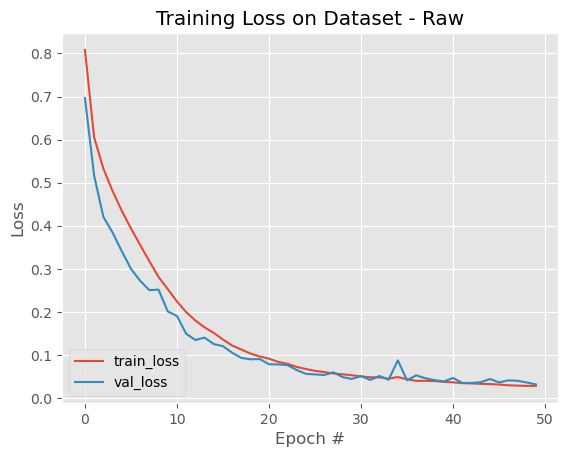

In [86]:
# plot the training loss - raw
plt.style.use("ggplot")
plt.figure()
plt.plot(history["train_loss"], label="train_loss")
plt.plot(history["val_loss"], label="val_loss")
plt.title("Training Loss on Dataset - Raw")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")

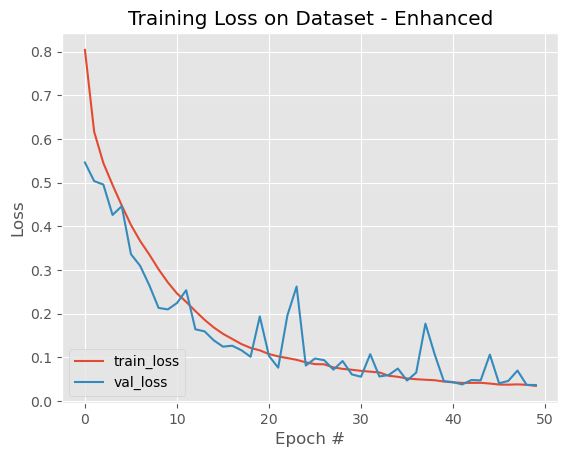

In [87]:
# plot the training loss - Enhanced
plt.style.use("ggplot")
plt.figure()
plt.plot(history_en["train_loss"], label="train_loss")
plt.plot(history_en["val_loss"], label="val_loss")
plt.title("Training Loss on Dataset - Enhanced")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")

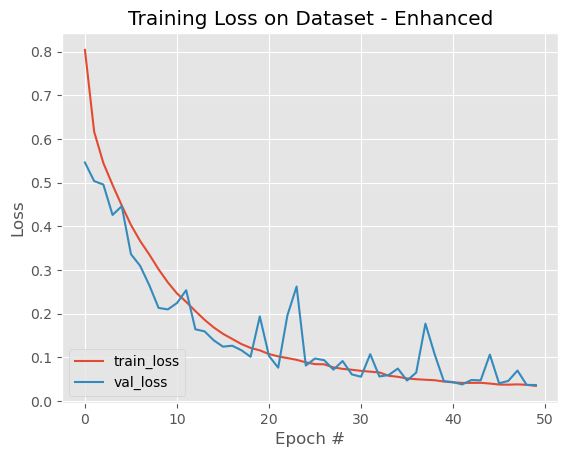

In [95]:
# plot the training loss - Enhanced
plt.style.use("ggplot")
plt.figure()
plt.plot(history_en["train_loss"], label="train_loss")
plt.plot(history_en["val_loss"], label="val_loss")
plt.title("Training Loss on Dataset - Enhanced")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")

- dresUnet

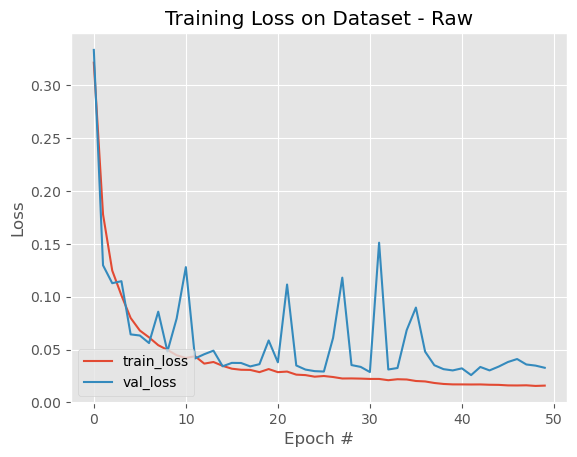

In [96]:
# plot the training loss - raw
plt.style.use("ggplot")
plt.figure()
plt.plot(history_2["train_loss"], label="train_loss")
plt.plot(history_2["val_loss"], label="val_loss")
plt.title("Training Loss on Dataset - Raw")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")

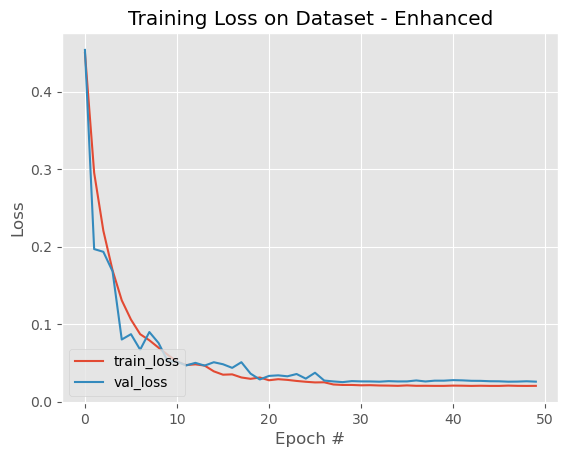

In [97]:
# plot the training loss - Enhanced
plt.style.use("ggplot")
plt.figure()
plt.plot(history_en_2["train_loss"], label="train_loss")
plt.plot(history_en_2["val_loss"], label="val_loss")
plt.title("Training Loss on Dataset - Enhanced")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")

##### Plot metrics - Dice, IoU, VS

In [88]:
def plot_all_metrics(histories, metric_name, title_base, colors=['black', 'gray', 'navy', 'darkgreen'], labels=['unet_raw', 'unet_enhanced', 'dresunet_raw', 'dresunet_enhanced']):
    plt.figure(figsize=(18, 6))

    for history, color, label in zip(histories, colors, labels):
        if metric_name == 'metric_dice':
            metric_data = history[metric_name][-1][1]  # Assuming last epoch's data for plotting
        elif metric_name == 'metric_jaccard':
            metric_data = history[metric_name][-1][1]
        elif metric_name == 'metric_vs':
            metric_data = history[metric_name]
        else:
            raise ValueError(f"Unknown metric name: {metric_name}")
        
        metric_values = np.array(metric_data)
        if metric_name == 'metric_vs':
            num_labels = 3
        else:
            num_labels = metric_values.shape[1]
        line_style = '--' if 'raw' in label else '-'

        for lbl in range(num_labels):
            plt.subplot(1, num_labels, lbl + 1)
            plt.title(f"{title_base} - Label {lbl}", fontsize=14)
            plt.xlabel("Epoch", fontsize=12)
            plt.ylabel(metric_name.replace('metric_', '').capitalize(), fontsize=12)  # Dice or IoU

            x = list(range(1, len(metric_values) + 1))
            if metric_name == 'metric_vs':
                 y = metric_values
            else:
                y = metric_values[:, lbl]
            plt.plot(x, y, color=color, linestyle=line_style, label=label)  # Cycle through colors if more labels than colors

    plt.tight_layout()
    plt.legend(loc='upper right', fontsize=12)
    plt.show()

In [109]:
all_histories = [history, history_en, history_2, history_en_2]

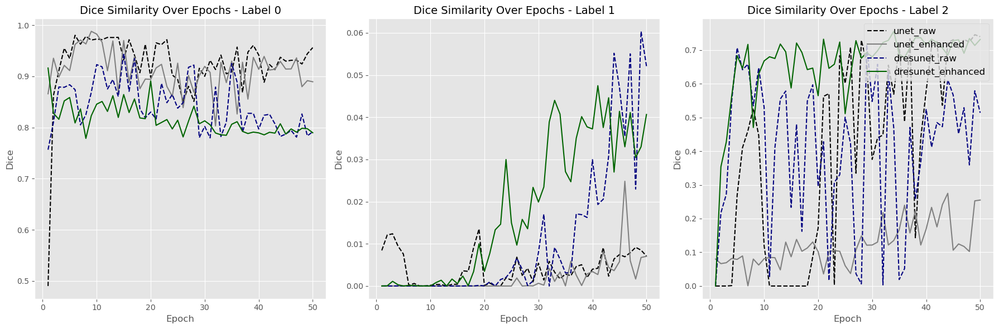

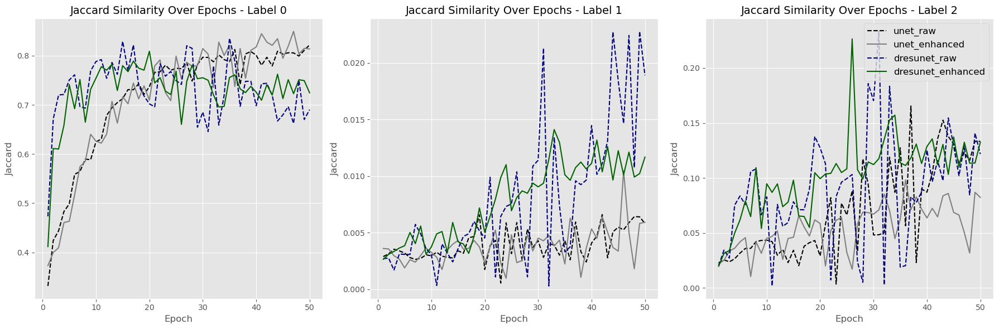

In [110]:
plot_all_metrics(all_histories, 'metric_dice', 'Dice Similarity Over Epochs')
plot_all_metrics(all_histories, 'metric_jaccard', 'Jaccard Similarity Over Epochs')

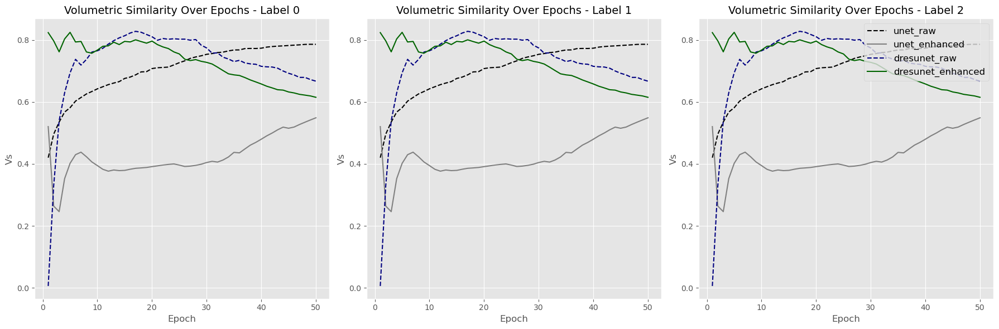

In [113]:
plot_all_metrics(all_histories, 'metric_vs', 'Volumetric Similarity Over Epochs')

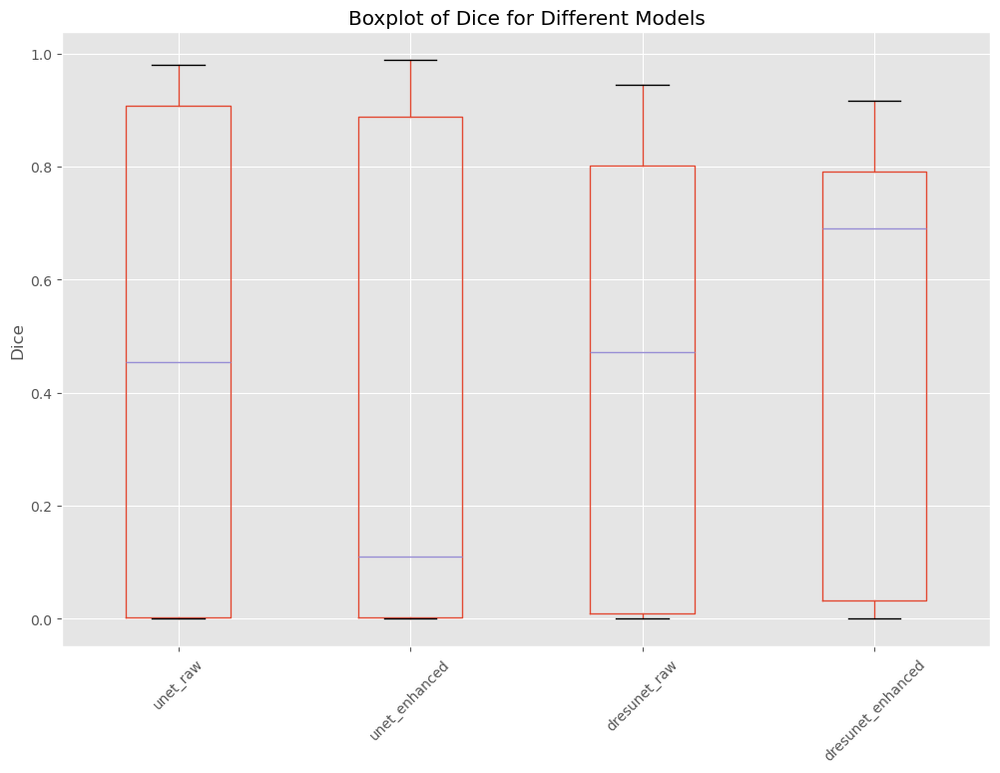

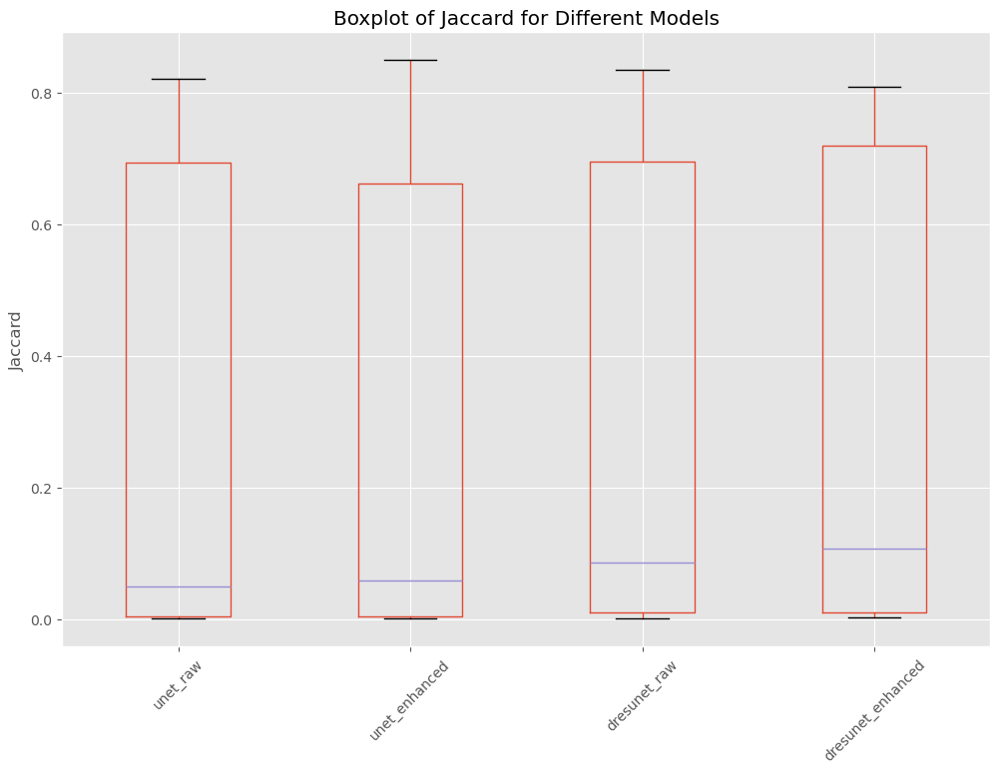

In [118]:
def create_boxplot_for_metrics(histories, metric_name, labels=['unet_raw', 'unet_enhanced', 'dresunet_raw', 'dresunet_enhanced']):
    data = []
    for history in histories:
        if metric_name in history:
            metric_data = history[metric_name]
            if metric_name == 'metric_vs':
                # Assuming metric_vs is a single array per history
                data.append(metric_data)
            else:
                # Flatten the 3D array to 2D for boxplotting
                metric_values = [np.array(epoch_data[1]).reshape(-1) for epoch_data in metric_data]
                data.append(np.concatenate(metric_values, axis=0))

    # Creating a DataFrame for plotting
    flattened_data = np.column_stack(data)
    df = pd.DataFrame(flattened_data, columns=labels)

    # Creating the boxplot
    plt.figure(figsize=(12, 8))
    df.boxplot()
    plt.title(f'Boxplot of {metric_name.replace("metric_", "").capitalize()} for Different Models')
    plt.ylabel(metric_name.replace('metric_', '').capitalize())
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.show()

#
# 
# histories = [history, history_en, history_2, history_en_2]
create_boxplot_for_metrics(all_histories, 'metric_dice')
create_boxplot_for_metrics(all_histories, 'metric_jaccard')

- Separated plots

In [114]:

def plot_metrics(history, metric_name, title_base, colors=['blue', 'brown', 'green', 'red']):
    # Fetching metrics from history
    if metric_name == 'metric_dice':
        metric_data = history[metric_name][-1][1]  # Assuming last epoch's data for plotting
    elif metric_name == 'metric_jaccard':
        metric_data = history[metric_name][-1][1]
    elif metric_name == 'metric_vs':
        metric_data = history[metric_name]
    else:
        raise ValueError(f"Unknown metric name: {metric_name}")
 
    # Convert to numpy array
    metric_values = np.array(metric_data)
 
    # Determine number of labels
    num_labels = metric_values.shape[1]
 
    # Create figure
    plt.figure(figsize=(18, 6))
    for label in range(num_labels):
        plt.subplot(1, num_labels, label + 1)
        plt.title(f"{title_base} - Label {label}")
        plt.xlabel("Epoch")
        plt.ylabel(metric_name.replace('metric_', '').capitalize())  # Dice or IoU
 
        # x values assuming validation occurs every epoch
        x = list(range(1, len(metric_values) + 1))
        y = metric_values[:, label]
        plt.plot(x, y, color=colors[label % len(colors)])  # Cycle through colors if more labels than colors
 
    plt.tight_layout()
    plt.show()

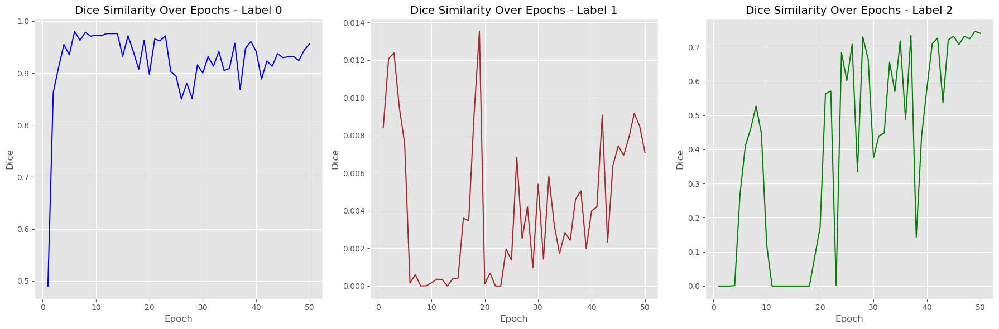

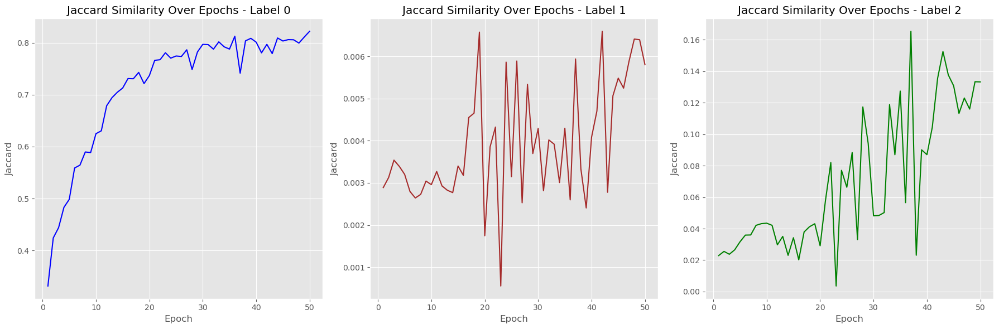

In [115]:
plot_metrics(history, 'metric_dice', 'Dice Similarity Over Epochs')#, colors=['blue'])
plot_metrics(history, 'metric_jaccard', 'Jaccard Similarity Over Epochs')#, colors=['brown'])

In [101]:
history['metric_vs']

[0.42018756747020514,
 0.49605496834820145,
 0.535153190044757,
 0.5673905553012772,
 0.5815608685587355,
 0.6028013787560386,
 0.6145225584728446,
 0.6259272729196617,
 0.6339162551128266,
 0.6424296177689947,
 0.6492827916879711,
 0.6560120344315431,
 0.6611542873051157,
 0.6657900748239973,
 0.6760347130902536,
 0.6804025559618369,
 0.6876051529148418,
 0.6971028336864502,
 0.6980151243080284,
 0.7078884516035133,
 0.71053916987985,
 0.7114915288412543,
 0.7126977533587481,
 0.71976943543649,
 0.7269095660694525,
 0.7328525919790392,
 0.740784490446399,
 0.745397425385319,
 0.7491094856854762,
 0.7538875188875989,
 0.7563245103298017,
 0.7595876970555063,
 0.7609962191644061,
 0.7649198084802966,
 0.7679737160622608,
 0.768173628094091,
 0.772381442708119,
 0.7728883099798931,
 0.772725878739855,
 0.7737017625761419,
 0.777201233190777,
 0.7790154272750833,
 0.780345322036079,
 0.7811677827634256,
 0.7823685868140556,
 0.7834846359910412,
 0.7845370832638909,
 0.7859112171597062,
 0

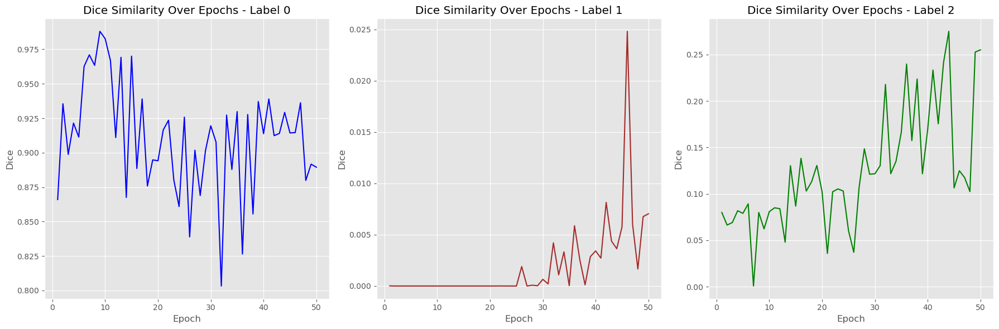

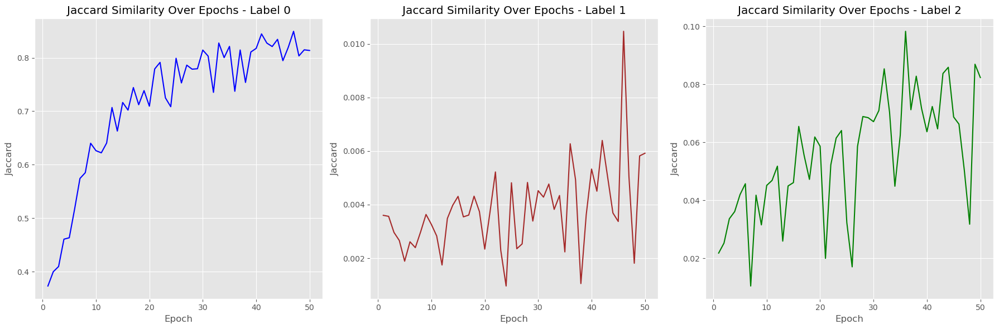

In [ ]:
plot_metrics(history_en, 'metric_dice', 'Dice Similarity Over Epochs')#, colors=['blue'])
plot_metrics(history_en, 'metric_jaccard', 'Jaccard Similarity Over Epochs')#, colors=['brown'])

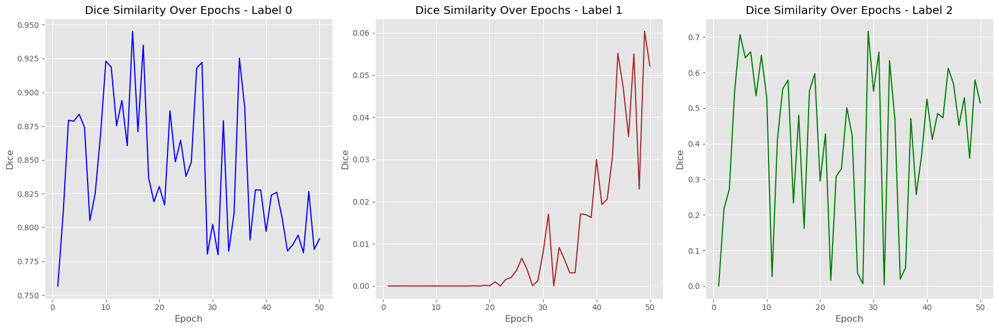

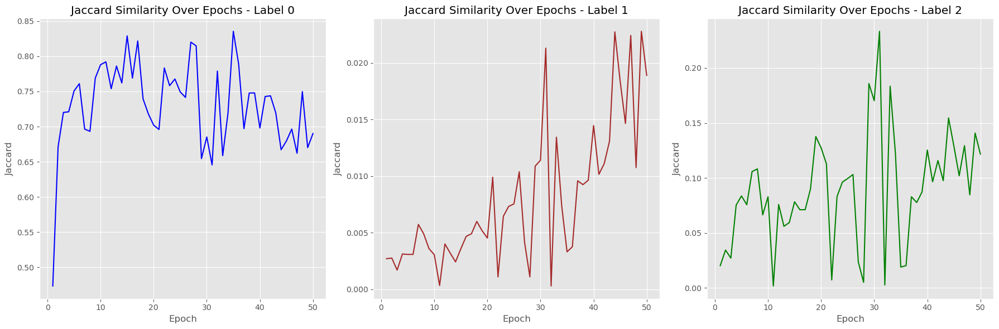

In [ ]:
plot_metrics(history_2, 'metric_dice', 'Dice Similarity Over Epochs')#, colors=['blue'])
plot_metrics(history_2, 'metric_jaccard', 'Jaccard Similarity Over Epochs')#, colors=['brown'])

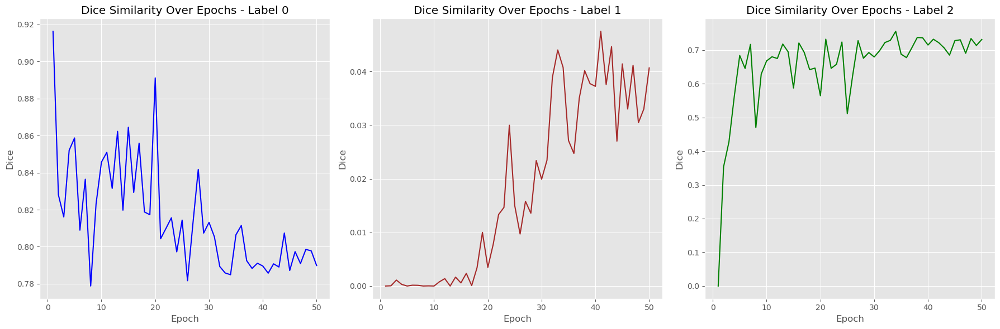

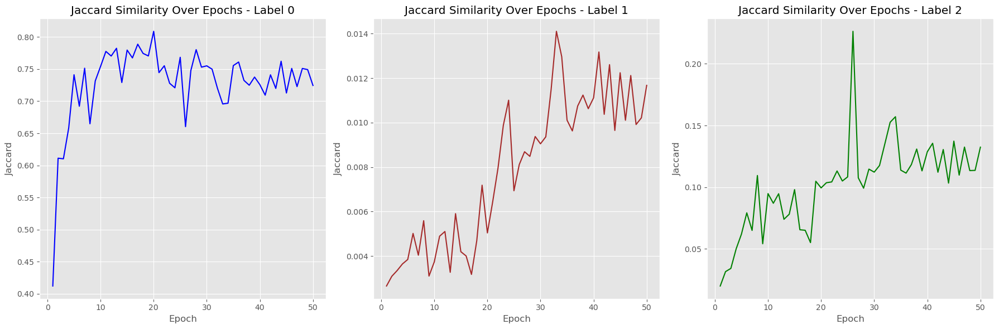

In [ ]:
plot_metrics(history_en_2, 'metric_dice', 'Dice Similarity Over Epochs')#, colors=['blue'])
plot_metrics(history_en_2, 'metric_jaccard', 'Jaccard Similarity Over Epochs')#, colors=['brown'])

#### 5.2) Load model

In [ ]:
# To load the model later
mdl = UNet(inchannels= in_channels, outchannels= out_classes, channels =channels).to(DEVICE)
mdl.load_state_dict(torch.load(PATH+f'unet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{"2025-02-13"}.pth'))#, map_location=torch.device(DEVICE)))
mdl.eval()  # Set the model to evaluation mode

C:\Users\Usuario\AppData\Local\Temp\ipykernel_24360\3831986976.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mdl.load_state_dict(torch.load(PATH+f'unet_model_v9_lr0-00

UNet(
  (encoder_1): encoder_block(
    (conv): conv_block(
      (conv1): Conv3d(2, 8, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn1): BatchNorm3d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv3d(8, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn2): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (pool): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (encoder_2): encoder_block(
    (conv): conv_block(
      (conv1): Conv3d(16, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn1): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv3d(16, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
      (bn2): BatchNorm3d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stat

In [ ]:
#from torchview import draw_graph
#model_graph = draw_graph(mdl, input_size=(1, 2, 320, 320, 16), expand_nested=True, depth=1)
#model_graph.visual_graph

In [ ]:
# To load the model later
mdl_2 = UNet(inchannels= in_channels, outchannels= out_classes, channels =channels).to(DEVICE)
mdl_2.load_state_dict(torch.load(PATH+f'dresunet_model_v10_lr0-0005_1M_{name_organ}_{data_info}_{"2025-02-13"}.pth'))#, map_location=torch.device(DEVICE)))
mdl_2.eval()  # Set the model to evaluation mode

In [ ]:
#from torchview import draw_graph
#model_graph = draw_graph(mdl_2, input_size=(1, 2, 320, 320, 16), expand_nested=True, depth=1)
#model_graph.visual_graph

##### Create GIF for Validation to compare volumes - also save image as nii file

In [ ]:
# to save this 3D (ndarry) numpy use this -last image

def save_to_nii(img, ground_truth, outputs, name='', n='', PATH='3DSlicer_plots/'):
    # Check if the directory exists, if not create it
    if not os.path.exists(PATH):
        os.makedirs(PATH)

    if img[0,:,:,:,:].shape[0] == 1:
        aa = img[0,:,:,:,:].squeeze().cpu().numpy() # if 1 modality
    else:
        aa = np.moveaxis(img[0,:,:,:,:].cpu().numpy(),0,-1)[:,:,:,0]

    bb = np.argmax(np.moveaxis(ground_truth[0,:,:,:,:].cpu().numpy(),0,-1), axis=-1).astype(np.float64)
    cc = np.argmax(outputs, axis=-1).astype(np.float64)

    nib.save(nib.Nifti1Image(aa, affine=np.eye(4)), PATH+f'{name}_{data_info}_img_v10_val_{n}.nii')
    nib.save(nib.Nifti1Image(bb, affine=np.eye(4)), PATH+f'{name}_{data_info}_ground_truth_v10_val_{n}.nii')
    nib.save(nib.Nifti1Image(cc, affine=np.eye(4)), PATH+f'{name}_{data_info}_predict_v10_val_{n}.nii')

    return

In [ ]:
def process_data(dataloader, mode, mdl, DEVICE, name_organ, data_info, model_name, PATH='3DSlicer_plots/'):
    for i, data in enumerate(dataloader):
        if mode == 'validation':
            img, ground_truth = data
        else:
            img = data
            ground_truth = None

        with torch.no_grad():
            mdl.eval()
            img = img.to(DEVICE)
            pred = mdl(img)
            outputs = torch.softmax(pred, dim=1).cpu().numpy()
            outputs = np.moveaxis(outputs[0,:,:,:,:], 0, -1)

        modality_index = range(img.shape[1])  # get all or change this to the desired modality
        annotation_index = range(outputs.shape[3])  # number of annotations
        
        if mode == 'validation':
            create_gif_3(np.moveaxis(img[0,:,:,:,:].cpu().numpy(), 0, -1), modality_index, outputs, annotation_index, PATH + 'figures/' + f'{model_name}_label_slices_val_1M_{name_organ}_{data_info}_{i}.gif')
            save_to_nii(img, ground_truth, outputs, model_name, name=name_organ, n=i)
        else:
            create_gif_3(np.moveaxis(img[0,:,:,:,:].cpu().numpy(), 0, -1), modality_index, outputs, annotation_index, PATH + f'{model_name}_test_label_slices_pred_1M_{name_organ}_{data_info}_{i}.gif')
            save_to_nii(img, ground_truth, outputs, model_name, name=name_organ+f'_{i}')

In [ ]:
process_data(val_dataloader, 'validation', mdl, DEVICE, name_organ, data_info, 'unet')

In [46]:
# compare with validation en 3D
for i,(img,ground_truth) in enumerate(val_dataloader):

    with torch.no_grad():
        mdl.eval()

        img = img.to(DEVICE)
        with torch.no_grad():
            pred = mdl(img)
            outputs = torch.softmax(pred, dim=1)
            outputs = outputs.cpu().numpy()
            print(outputs.shape)
            outputs = np.moveaxis(outputs[0,:,:,:,:], 0, -1)
            print(outputs.shape)

    #modality_index = range(outputs.shape[3])  #change this to the desired modality
    modality_index = range(img.shape[1])  # get all or change this to the desired modality
    annotation_index = range(outputs.shape[3])  # number of annotations
    print(img.shape, modality_index)
    
    # create gif and store them in a directory
    create_gif_3(np.moveaxis(img[0,:,:,:,:].cpu().numpy(), 0, -1), modality_index, outputs, annotation_index, PATH + 'figures/' + f'label_slices_val_1M_{name_organ}_{data_info}_{i}.gif')

    # save it as nii file
    save_to_nii(img, ground_truth, outputs, name=name_organ, n=i)

(1, 2, 320, 320, 130)
(320, 320, 130, 2)
torch.Size([1, 1, 320, 320, 130]) range(0, 1)
(320, 320, 130, 1)
(320, 320, 130, 2)


/tmp/ipykernel_5048/1820221737.py:153: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')


(1, 2, 320, 320, 122)
(320, 320, 122, 2)
torch.Size([1, 1, 320, 320, 122]) range(0, 1)
(320, 320, 122, 1)
(320, 320, 122, 2)
(1, 2, 320, 320, 120)
(320, 320, 120, 2)
torch.Size([1, 1, 320, 320, 120]) range(0, 1)
(320, 320, 120, 1)
(320, 320, 120, 2)
(1, 2, 320, 320, 90)
(320, 320, 90, 2)
torch.Size([1, 1, 320, 320, 90]) range(0, 1)
(320, 320, 90, 1)
(320, 320, 90, 2)
(1, 2, 320, 320, 110)
(320, 320, 110, 2)
torch.Size([1, 1, 320, 320, 110]) range(0, 1)
(320, 320, 110, 1)
(320, 320, 110, 2)


In [ ]:
#save_to_nii(img, ground_truth, outputs, name=name_organ)

##### Create GIF for TEST

In [ ]:
process_data(test_dataloader, 'test', mdl, DEVICE, name_organ, data_info, 'unet')

In [ ]:
# compare with TEST en 3D
for i,img in enumerate(test_dataloader):

    with torch.no_grad():
        mdl.eval()

        img = img.to(DEVICE)
        with torch.no_grad():
            pred = mdl(img)
            outputs = torch.softmax(pred, dim=1)
            outputs = outputs.cpu().numpy()
            print(outputs.shape)
            outputs = np.moveaxis(outputs[0,:,:,:,:], 0, -1)
            print(outputs.shape)

    #modality_index = range(outputs.shape[3])  #change this to the desired modality
    modality_index = range(img.shape[1])  # get all or change this to the desired modality
    annotation_index = range(outputs.shape[3])  # number of annotations
    print(img.shape, modality_index)
    create_gif_3(np.moveaxis(img[0,:,:,:,:].cpu().numpy(), 0, -1), modality_index, outputs, annotation_index, PATH + f'heart_label_slices_pred_{i}_1M_test.gif')

    # to save this 3D (ndarry) numpy use this -last image
    save_to_nii(img, ground_truth, outputs, name=name_organ+f'_{i}')

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.72 GiB. GPU 0 has a total capacity of 14.75 GiB of which 475.06 MiB is free. Process 10739 has 14.28 GiB memory in use. Of the allocated memory 13.22 GiB is allocated by PyTorch, and 957.52 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

### 5.2) Volumetric segmentation

In [ ]:
# load figure

from PIL import Image
import numpy as np

def load_png_image(file_path):
    with Image.open(file_path) as img:
        img_array = np.array(img)
    return img_array

# Example usage:
# image_data = load_png_image('path/to/image.png')


In [ ]:
# load table

import pandas as pd

def load_csv(file_path):
    df = pd.read_csv(file_path)
    return df

# Example usage:
# csv_data = load_csv('path/to/data.csv')


# Convert dictionary to DataFrame
df_history = pd.DataFrame(history)
df_history_en = pd.DataFrame(history_en)
df_history_en_2 = pd.DataFrame(history_en_2)


In [ ]:
# compare difference

import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
def load_csv(file_path):
    df = pd.read_csv(file_path)
    return df

# Example usage:
# csv_data = load_csv('path/to/statistics.csv')

# Compare Segmentation Statistics
def compare_segmentation_stats(csv_data, feature_1, feature_2):
    plt.figure(figsize=(10, 6))
    plt.scatter(csv_data[feature_1], csv_data[feature_2], alpha=0.5)
    plt.title(f'Comparison of {feature_1} and {feature_2}')
    plt.xlabel(feature_1)
    plt.ylabel(feature_2)
    plt.show()

# Example usage:
# compare_segmentation_stats(csv_data, 'DiceCoefficient', 'JaccardIndex')
